# 1: Setup

In [6]:
!pip install tensorflow==2.4.1 tensorflow-gpu==2.4.1 opencv-python matplotlib

ERROR: Could not find a version that satisfies the requirement tensorflow==2.4.1 (from versions: 2.16.0rc0, 2.16.1, 2.16.2, 2.17.0rc0, 2.17.0rc1, 2.17.0, 2.17.1, 2.18.0rc0, 2.18.0rc1, 2.18.0rc2, 2.18.0)
ERROR: No matching distribution found for tensorflow==2.4.1


In [7]:
import cv2
import os
import random
import numpy as np
from matplotlib import pyplot as plt

In [8]:
# Import tensorflow dependencies - Functional API
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Layer, Conv2D, Dense, MaxPooling2D, Input, Flatten
import tensorflow as tf

In [9]:
# Avoid OOM errors by setting GPU Memory Consumption Growth
gpus = tf.config.experimental.list_physical_devices('GPU')
for gpu in gpus: 
    tf.config.experimental.set_memory_growth(gpu, True)


# 2: Folders 

In [10]:
# Setup paths
POS_PATH = os.path.join('data', 'positive')
NEG_PATH = os.path.join('data', 'negative')
ANC_PATH = os.path.join('data', 'anchor')
VAL_PATH = os.path.join('application_data', 'verification_images')

In [11]:
# Make the directories
os.makedirs(POS_PATH)
os.makedirs(NEG_PATH)
os.makedirs(ANC_PATH)

FileExistsError: [WinError 183] Cannot create a file when that file already exists: 'data\\positive'

In [12]:
for directory in os.listdir('dataset'):
    for file in os.listdir(os.path.join('dataset', directory)):
        EX_PATH = os.path.join('dataset', directory, file)
        NEW_PATH = os.path.join(NEG_PATH, file)
        os.replace(EX_PATH, NEW_PATH)

# 3: Dataset

In [13]:
import uuid

In [14]:
os.path.join(ANC_PATH, '{}.jpg'.format(uuid.uuid1()))

'data\\anchor\\4a611454-ee69-11ef-a8e2-f47b09537135.jpg'

In [15]:
# Establish a connection to the webcam
cap = cv2.VideoCapture(0)
while cap.isOpened(): 
    ret, frame = cap.read()
   
    # Cut down frame to 250x250px
    frame = frame[120:120+250,200:200+250, :]
    
    # Collect anchors 
    if cv2.waitKey(1) & 0XFF == ord('a'):
        # Create the unique file path 
        imgname = os.path.join(ANC_PATH, '{}.jpg'.format(uuid.uuid1()))
        # Write out anchor image
        cv2.imwrite(imgname, frame)
    
    # Collect positives
    if cv2.waitKey(1) & 0XFF == ord('p'):
        # Create the unique file path 
        imgname = os.path.join(POS_PATH, '{}.jpg'.format(uuid.uuid1()))
        # Write out positive image
        cv2.imwrite(imgname, frame)
    
    # Show image back to screen
    cv2.imshow('Image Collection', frame)
    
    # Breaking gracefully
    if cv2.waitKey(1) & 0XFF == ord('q'):
        break
        
# Release the webcam
cap.release()
# Close the image show frame
cv2.destroyAllWindows()

# 4: Data loading 

In [16]:
anchor = tf.data.Dataset.list_files(ANC_PATH+'\\*.jpg').take(3000)
positive = tf.data.Dataset.list_files(POS_PATH+'\\*.jpg').take(3000)
negative = tf.data.Dataset.list_files(NEG_PATH+'\\*.jpg').take(3000)

In [17]:
dir_test = anchor.as_numpy_iterator()

In [18]:
print(dir_test.next())

b'data\\anchor\\George_W_Bush_0129.jpg'


In [19]:
def preprocess(file_path):
    
    # Read in image from file path
    byte_img = tf.io.read_file(file_path)
    # Load in the image 
    img = tf.io.decode_jpeg(byte_img)
    
    # Preprocessing steps - resizing the image to be 100x100x3
    img = tf.image.resize(img, (100,100))
    # Scale image to be between 0 and 1 
    img = img / 255.0

    # Return image
    return img

# 5: Creating labels

In [20]:
# (anchor, positive) => 1,1,1,1,1
# (anchor, negative) => 0,0,0,0,0

In [21]:
min_length = min(len(anchor), len(negative))  # Ensure equal length
anchor = anchor.take(min_length)
positive = positive.take(min_length)
negative = negative.take(min_length)


In [22]:
positives = tf.data.Dataset.zip((anchor, positive, tf.data.Dataset.from_tensor_slices(tf.ones(len(anchor)))))
negatives = tf.data.Dataset.zip((anchor, negative, tf.data.Dataset.from_tensor_slices(tf.zeros(len(anchor)))))
data = negatives.concatenate(positives).shuffle(buffer_size=1000)


In [23]:
samples = data.as_numpy_iterator()

In [30]:
samples.next()

(b'data\\anchor\\George_W_Bush_0114.jpg',
 b'data\\negative\\Ralph_Lauren_0002.jpg',
 0.0)

In [31]:
exampple = samples.next()

In [32]:
exampple

(b'data\\anchor\\George_W_Bush_0103.jpg',
 b'data\\negative\\Bill_Doba_0001.jpg',
 0.0)

# 6: Train and test partition

In [33]:
def preprocess_twin(input_img, validation_img, label):
    return(preprocess(input_img), preprocess(validation_img), label)

In [34]:
res = preprocess_twin(*exampple)

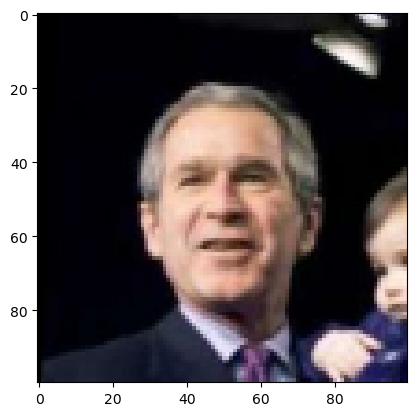

In [35]:
plt.imshow(res[0])

In [36]:
res[1]

<tf.Tensor: shape=(100, 100, 3), dtype=float32, numpy=
array([[[0.        , 0.        , 0.        ],
        [0.        , 0.        , 0.        ],
        [0.        , 0.        , 0.        ],
        ...,
        [0.1254902 , 0.13333334, 0.09019608],
        [0.12843138, 0.13627452, 0.09313726],
        [0.11960784, 0.12745099, 0.08431373]],

       [[0.        , 0.        , 0.        ],
        [0.        , 0.        , 0.        ],
        [0.        , 0.        , 0.        ],
        ...,
        [0.1254902 , 0.13333334, 0.09019608],
        [0.12843138, 0.13627452, 0.09313726],
        [0.12843138, 0.13627452, 0.09313726]],

       [[0.        , 0.        , 0.        ],
        [0.        , 0.        , 0.        ],
        [0.        , 0.        , 0.        ],
        ...,
        [0.1254902 , 0.13333334, 0.09019608],
        [0.12843138, 0.13627452, 0.09313726],
        [0.12156863, 0.12941177, 0.08627451]],

       ...,

       [[0.        , 0.        , 0.        ],
        [0.  

In [37]:
# Build dataloader pipeline
data = data.map(preprocess_twin)
data = data.cache()
data = data.shuffle(buffer_size=10000)

In [38]:
# Training partition
train_data = data.take(round(len(data)*.7))
train_data = train_data.batch(32)
train_data = train_data.prefetch(8)

In [39]:
# Testing partition
test_data = data.skip(round(len(data)*.7))
test_data = test_data.take(round(len(data)*.3))
test_data = test_data.batch(200)
test_data = test_data.prefetch(8)

# 7: Embedding layer

In [637]:
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, AveragePooling2D, BatchNormalization
from tensorflow.keras.layers import Activation, concatenate, Add, Flatten, Dense, GlobalAveragePooling2D
from tensorflow.keras.models import Model

In [638]:
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, concatenate, add, Flatten, Dense, Activation, Lambda
from tensorflow.keras.models import Model

In [639]:
# def inception_resnet_block(x, filters, block_name):
#     # Branch 1: 1x1 Convolution
#     branch_1 = Conv2D(filters, (1, 1), padding='same', activation='relu', name=block_name + '_branch1_conv')(x)
    
#     # Branch 2: 1x1 followed by 3x3 Convolution
#     branch_2 = Conv2D(filters, (1, 1), padding='same', activation='relu', name=block_name + '_branch2_conv1')(x)
#     branch_2 = Conv2D(filters, (3, 3), padding='same', activation='relu', name=block_name + '_branch2_conv2')(branch_2)
    
#     # Branch 3: 1x1 followed by 5x5 Convolution
#     branch_3 = Conv2D(filters, (1, 1), padding='same', activation='relu', name=block_name + '_branch3_conv1')(x)
#     branch_3 = Conv2D(filters, (5, 5), padding='same', activation='relu', name=block_name + '_branch3_conv2')(branch_3)
    
#     # Branch 4: 3x3 MaxPooling followed by 1x1 Convolution
#     branch_4 = MaxPooling2D((3, 3), strides=(1, 1), padding='same', name=block_name + '_branch4_pool')(x)
#     branch_4 = Conv2D(filters, (1, 1), padding='same', activation='relu', name=block_name + '_branch4_conv')(branch_4)
    
#     # Concatenate all branches
#     concatenated = concatenate([branch_1, branch_2, branch_3, branch_4], axis=-1, name=block_name + '_concat')
    
#     # Residual connection: Add input `x` to the concatenated output
#     residual = Conv2D(concatenated.shape[-1], (1, 1), padding='same', activation=None, name=block_name + '_residual_conv')(x)
#     output = Add(name=block_name + '_add')([concatenated, residual])
    
#     # Batch Normalization and Activation
#     output = BatchNormalization(name=block_name + '_bn')(output)
#     output = Activation('relu', name=block_name + '_activation')(output)
    
#     return output

In [640]:
def inception_resnet_block(x, filters, block_name):
    # Branch 1: 1x1 Convolution
    branch_1 = Conv2D(filters, (1, 1), padding='same', activation='relu', name=block_name + '_branch1_conv')(x)

    # Branch 2: 1x1 followed by 3x3 Convolution
    branch_2 = Conv2D(filters, (1, 1), padding='same', activation='relu', name=block_name + '_branch2_conv1')(x)
    branch_2 = Conv2D(filters, (3, 3), padding='same', activation='relu', name=block_name + '_branch2_conv2')(branch_2)

    # Branch 3: 1x1 followed by 5x5 Convolution
    branch_3 = Conv2D(filters, (1, 1), padding='same', activation='relu', name=block_name + '_branch3_conv1')(x)
    branch_3 = Conv2D(filters, (5, 5), padding='same', activation='relu', name=block_name + '_branch3_conv2')(branch_3)

    # Branch 4: 3x3 MaxPooling followed by 1x1 Convolution
    branch_4 = MaxPooling2D((3, 3), strides=(1, 1), padding='same', name=block_name + '_branch4_pool')(x)
    branch_4 = Conv2D(filters, (1, 1), padding='same', activation='relu', name=block_name + '_branch4_conv')(branch_4)

    # Concatenate all branches
    concatenated = concatenate([branch_1, branch_2, branch_3, branch_4], axis=-1, name=block_name + '_concat')

    # Residual Connection (1x1 Conv to match dimensions)
    residual = Conv2D(concatenated.shape[-1], (1, 1), padding='same', activation=None, name=block_name + '_residual_conv')(x)
    output = Add(name=block_name + '_add')([concatenated, residual])

    # Batch Normalization and Activation
    output = BatchNormalization(name=block_name + '_bn')(output)
    output = Activation('relu', name=block_name + '_activation')(output)

    return output


In [641]:

# def make_inception_resnet_embedding(input_shape=(100, 100, 3), embedding_dim=128):
#     inp = Input(shape=input_shape, name='input_image')
    
#     # Initial Conv Layer
#     x = Conv2D(64, (3, 3), padding='same', activation='relu', name='conv1')(inp)
#     x = MaxPooling2D((2, 2), padding='same', name='pool1')(x)
    
#     # Add Inception-ResNet Blocks
#     x = inception_resnet_block(x, filters=32, block_name='block1')
#     x = inception_resnet_block(x, filters=64, block_name='block2')
#     x = inception_resnet_block(x, filters=128, block_name='block3')
    
#     # Global Average Pooling
#     x = GlobalAveragePooling2D(name='global_avg_pooling')(x)
    
#     # Fully Connected Layer for Embedding
#     embedding = Dense(embedding_dim, activation=None, name='embedding')(x)  # Raw embeddings, no activation
    
#     # Define the final model
#     model = Model(inputs=[inp], outputs=[embedding], name='custom_inception_resnet_embedding')
#     model.summary()
#     return model
# make_inception_resnet_embedding()

In [642]:
def make_inception_resnet_embedding(input_shape=(100, 100, 3), embedding_dim=4096):
    inp = Input(shape=input_shape, name='input_image')

    # Initial Conv Layer
    x = Conv2D(64, (3, 3), padding='same', activation='relu', name='conv2d_8')(inp)
    x = MaxPooling2D((2, 2), padding='same', name='max_pooling2d_6')(x)

    # Inception-ResNet Blocks
    x = inception_resnet_block(x, filters=64, block_name='block1')
    x = MaxPooling2D((2, 2), padding='same', name='max_pooling2d_7')(x)

    x = inception_resnet_block(x, filters=128, block_name='block2')
    x = MaxPooling2D((2, 2), padding='same', name='max_pooling2d_8')(x)

    x = inception_resnet_block(x, filters=256, block_name='block3')

    # Final Conv Layer (like in summary)
    x = Conv2D(256, (3, 3), padding='same', activation='relu', name='conv2d_11')(x)

    # Flatten and Fully Connected Embedding Layer
    x = Flatten(name='flatten_2')(x)
    embedding = Dense(embedding_dim, activation=None, name='dense_4')(x)  # No activation for raw embeddings

    # Define the model
    model = Model(inputs=[inp], outputs=[embedding], name='embedding')
    model.summary()
    return model

# Create the Model
make_inception_resnet_embedding()

Model: "embedding"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_image         │ (None, 100, 100,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_8 (Conv2D)   │ (None, 100, 100,  │      1,792 │ input_image[0][0] │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_6     │ (None, 50, 50,    │          0 │ conv2d_8[0][0]    │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_branch2_con… │ (None, 50, 50,    │      4,160 │ max_pooling2d_6[… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_branch3_con… │ (None, 50, 50,    │      4,160 │ max_pooling2d_6[… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_branch4_pool │ (None, 50, 50,    │          0 │ max_pooling2d_6[… │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_branch1_conv │ (None, 50, 50,    │      4,160 │ max_pooling2d_6[… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_branch2_con… │ (None, 50, 50,    │     36,928 │ block1_branch2_c… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_branch3_con… │ (None, 50, 50,    │    102,464 │ block1_branch3_c… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_branch4_conv │ (None, 50, 50,    │      4,160 │ block1_branch4_p… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_concat       │ (None, 50, 50,    │          0 │ block1_branch1_c… │
│ (Concatenate)       │ 256)              │            │ block1_branch2_c… │
│                     │                   │            │ block1_branch3_c… │
│                     │                   │            │ block1_branch4_c… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_residual_co… │ (None, 50, 50,    │     16,640 │ max_pooling2d_6[… │
│ (Conv2D)            │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_add (Add)    │ (None, 50, 50,    │          0 │ block1_concat[0]… │
│                     │ 256)              │            │ block1_residual_… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_bn           │ (None, 50, 50,    │      1,024 │ block1_add[0][0]  │
│ (BatchNormalizatio… │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_activation   │ (None, 50, 50,    │          0 │ block1_bn[0][0]   │
│ (Activation)        │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_7     │ (None, 25, 25,    │          0 │ block1_activatio… │
│ (MaxPooling2D)      │ 256)              │            │                 

 Total params: 183,854,464 (701.35 MB)

 Trainable params: 183,850,880 (701.34 MB)

 Non-trainable params: 3,584 (14.00 KB)

<Functional name=embedding, built=True>

In [643]:
embedding = make_inception_resnet_embedding()

Model: "embedding"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_image         │ (None, 100, 100,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_8 (Conv2D)   │ (None, 100, 100,  │      1,792 │ input_image[0][0] │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_6     │ (None, 50, 50,    │          0 │ conv2d_8[0][0]    │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_branch2_con… │ (None, 50, 50,    │      4,160 │ max_pooling2d_6[… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_branch3_con… │ (None, 50, 50,    │      4,160 │ max_pooling2d_6[… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_branch4_pool │ (None, 50, 50,    │          0 │ max_pooling2d_6[… │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_branch1_conv │ (None, 50, 50,    │      4,160 │ max_pooling2d_6[… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_branch2_con… │ (None, 50, 50,    │     36,928 │ block1_branch2_c… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_branch3_con… │ (None, 50, 50,    │    102,464 │ block1_branch3_c… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_branch4_conv │ (None, 50, 50,    │      4,160 │ block1_branch4_p… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_concat       │ (None, 50, 50,    │          0 │ block1_branch1_c… │
│ (Concatenate)       │ 256)              │            │ block1_branch2_c… │
│                     │                   │            │ block1_branch3_c… │
│                     │                   │            │ block1_branch4_c… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_residual_co… │ (None, 50, 50,    │     16,640 │ max_pooling2d_6[… │
│ (Conv2D)            │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_add (Add)    │ (None, 50, 50,    │          0 │ block1_concat[0]… │
│                     │ 256)              │            │ block1_residual_… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_bn           │ (None, 50, 50,    │      1,024 │ block1_add[0][0]  │
│ (BatchNormalizatio… │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_activation   │ (None, 50, 50,    │          0 │ block1_bn[0][0]   │
│ (Activation)        │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_7     │ (None, 25, 25,    │          0 │ block1_activatio… │
│ (MaxPooling2D)      │ 256)              │            │                 

 Total params: 183,854,464 (701.35 MB)

 Trainable params: 183,850,880 (701.34 MB)

 Non-trainable params: 3,584 (14.00 KB)

# 8: Distance layer

In [40]:
# Siamese L1 Distance class
class L1Dist(Layer):
    
    # Init method - inheritance
    def __init__(self, **kwargs):
        super().__init__()
       
    # Magic happens here - similarity calculation
    def call(self, input_embedding, validation_embedding):
        return tf.math.abs(input_embedding - validation_embedding)



# 9: Siamese Model

In [645]:
input_image = Input(name='input_img', shape=(100,100,3))
validation_image = Input(name='validation_img', shape=(100,100,3))

In [646]:

inp_embedding = embedding(input_image)
val_embedding = embedding(validation_image)

In [647]:
siamese_layer = L1Dist()

In [648]:
from tensorflow.keras.layers import Reshape, Dense
distances = siamese_layer(inp_embedding[0], val_embedding[0])
distances = Reshape((-1, 1))(distances)

In [649]:
classifier = Dense(1, activation='sigmoid')(distances)

In [650]:
siamese_network = Model(inputs=[input_image, validation_image], outputs=classifier, name='SiameseNetwork')

In [651]:
siamese_network.summary()

Model: "SiameseNetwork"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_img           │ (None, 100, 100,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ validation_img      │ (None, 100, 100,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ embedding           │ (None, 4096)      │ 183,854,4… │ input_img[0][0],  │
│ (Functional)        │                   │            │ validation_img[0… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ l1_dist_8 (L1Dist)  │ (None, 4096)      │          0 │ embedding[0][0],  │
│                     │                   │            │ embedding[1][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ reshape_3 (Reshape) │ (None, 4096, 1)   │          0 │ l1_dist_8[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_6 (Dense)     │ (None, 4096, 1)   │          2 │ reshape_3[0][0]   │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 183,854,466 (701.35 MB)

 Trainable params: 183,850,882 (701.34 MB)

 Non-trainable params: 3,584 (14.00 KB)

In [652]:
def make_siamese_model(): 
    
    # Anchor image input in the network
    input_image = Input(name='input_image', shape=(100,100,3))
    
    # Validation image in the network 
    validation_image = Input(name='validation_img', shape=(100,100,3))
    
    # Get embeddings from the embedding model
    embedding_input = embedding(input_image)  # embedding(input_image) might return a list
    embedding_validation = embedding(validation_image)  # same for validation_image
    
    # If embedding() returns a list, you can access the first element like so:
    embedding_input = embedding_input[0] if isinstance(embedding_input, list) else embedding_input
    embedding_validation = embedding_validation[0] if isinstance(embedding_validation, list) else embedding_validation
    
    # Combine siamese distance components
    siamese_layer = L1Dist()
    siamese_layer._name = 'distance'
    distances = siamese_layer(embedding_input, embedding_validation)
    
    # Classification layer 
    classifier = Dense(1, activation='sigmoid')(distances)
    
    return Model(inputs=[input_image, validation_image], outputs=classifier, name='SiameseNetwork')


In [653]:
siamese_model = make_siamese_model()

In [654]:
siamese_model.summary()

Model: "SiameseNetwork"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_image         │ (None, 100, 100,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ validation_img      │ (None, 100, 100,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ embedding           │ (None, 4096)      │ 183,854,4… │ input_image[0][0… │
│ (Functional)        │                   │            │ validation_img[0… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ l1_dist_9 (L1Dist)  │ (None, 4096)      │          0 │ embedding[2][0],  │
│                     │                   │            │ embedding[3][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_7 (Dense)     │ (None, 1)         │      4,097 │ l1_dist_9[0][0]   │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 183,858,561 (701.36 MB)

 Trainable params: 183,854,977 (701.35 MB)

 Non-trainable params: 3,584 (14.00 KB)

# 10: Training

In [655]:
binary_cross_loss = tf.losses.BinaryCrossentropy()

In [656]:
# opt = tf.keras.optimizers.Adam(0.0001) 
lr_schedule = tf.keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate=0.001,
    decay_steps=1000,
    decay_rate=0.9)
opt = tf.keras.optimizers.Adam(learning_rate=lr_schedule)


In [657]:
test_batch = train_data.as_numpy_iterator()
batch_1 = test_batch.next()
X = batch_1[:2]
y = batch_1[2]
y

array([1., 1., 0., 1., 0., 1., 0., 1., 1., 0., 1., 1., 1., 0., 1., 0., 0.,
       0., 0., 0., 1., 0., 1., 1., 0., 0., 0., 1., 0., 1., 1., 1.],
      dtype=float32)

In [658]:
@tf.function
def train_step(batch):
    
    # Record all of our operations 
    with tf.GradientTape() as tape:     
        # Get anchor and positive/negative image
        X = batch[:2]
        # Get label
        y = batch[2]
        
        # Forward pass
        yhat = siamese_model(X, training=True)
        # Calculate loss
        loss = binary_cross_loss(y, yhat)
    print(loss)
        
    # Calculate gradients
    grad = tape.gradient(loss, siamese_model.trainable_variables)
    
    # Calculate updated weights and apply to siamese model
    opt.apply_gradients(zip(grad, siamese_model.trainable_variables))
        
    # Return loss
    return loss

In [659]:
# Import metric calculations
from tensorflow.keras.metrics import Precision, Recall

In [660]:
loss_values = []
recall_values = []
precision_values = []
def train(data, EPOCHS):
    # Loop through epochs
    for epoch in range(1, EPOCHS+1):
        print('\n Epoch {}/{}'.format(epoch, EPOCHS))
        progbar = tf.keras.utils.Progbar(len(data))
        
        # Creating a metric object 
        r = Recall()
        p = Precision()
        
        # Loop through each batch
        for idx, batch in enumerate(data):
            # Run train step here
            loss = train_step(batch)
            yhat = siamese_model.predict(batch[:2])
            yhat = tf.squeeze(yhat,axis=-1)
            r.update_state(batch[2], yhat)
            p.update_state(batch[2], yhat) 
            progbar.update(idx+1)
        print(loss.numpy(), r.result().numpy(), p.result().numpy())
        loss_values.append(loss.numpy())
        recall_values.append(r.result().numpy())
        precision_values.append(p.result().numpy())
        

In [661]:
EPOCHS = 100

In [662]:
train(train_data, EPOCHS)
siamese_model.save('face_recognition_modelv7.h5')


 Epoch 1/100
Tensor("binary_crossentropy/div_no_nan:0", shape=(), dtype=float32)
Tensor("binary_crossentropy/div_no_nan:0", shape=(), dtype=float32)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 715ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 695ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 719ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 702ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 665ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 701ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 684ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 681ms/step
 9/10 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step

C:\Users\Acer\anaconda3\Lib\site-packages\keras\src\models\functional.py:237: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: ['input_image']
Received: inputs=Tensor(shape=(13, 100, 100, 3))
  warnings.warn(msg)


Tensor("binary_crossentropy/div_no_nan:0", shape=(), dtype=float32)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 796ms/step
10/10 ━━━━━━━━━━━━━━━━━━━━ 54s 5s/step
6.1943564 0.5131579 0.53061223

 Epoch 2/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 686ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 674ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 704ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 687ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 691ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 705ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 690ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 803ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 702ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 384ms/step
10/10 ━━━━━━━━━━━━━━━━━━━━ 43s 4s/step
0.9992432 0.45637584 0.5151515

 Epoch 3/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 692ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 707ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 888ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 764ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 738ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 725ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 712ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 703ms/step
1/1 ━━━━━━━━━━━━━━━━━━━

0.00011031552 1.0 1.0


In [1]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))  # Adjust figure size
num_epochs = 100

# Plot loss
plt.plot(range(1, num_epochs + 1), loss_values, label='Loss', color='royalblue', linewidth=2)

# Formatting
plt.xlabel('Epochs', fontsize=14, fontweight='bold')
plt.ylabel('Loss', fontsize=14, fontweight='bold')
plt.title('Loss vs Epochs', fontsize=16, fontweight='bold')

# Add grid and legend
plt.grid(True, linestyle='--', alpha=0.6)
plt.legend(fontsize=12)

# Improve spacing
plt.tight_layout()

plt.savefig("loss vs epochs")
# Show the plot
plt.show()



NameError: name 'loss_values' is not defined

<Figure size 1000x600 with 0 Axes>

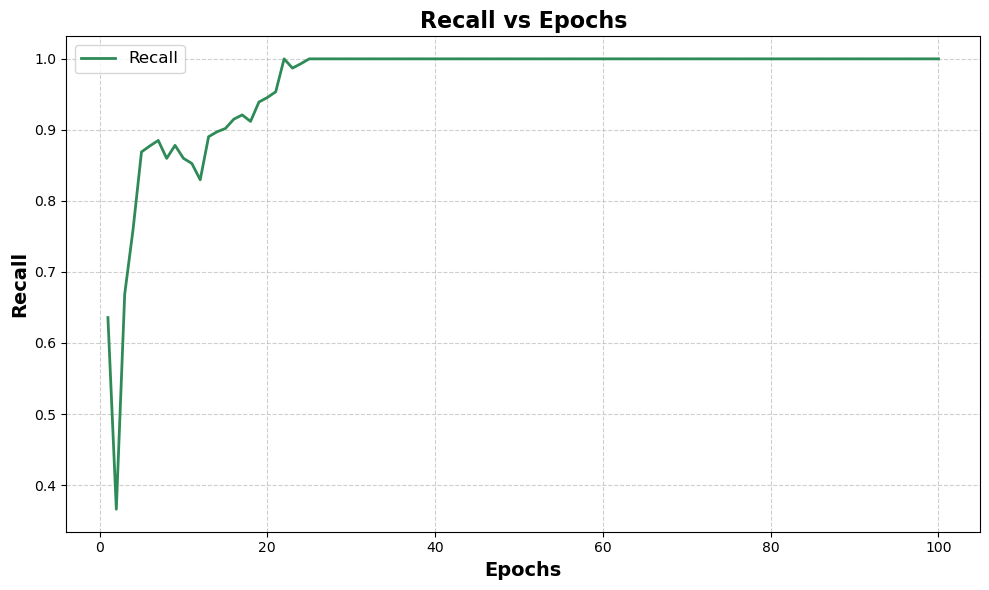

In [440]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))  # Adjust figure size
num_epochs = 100

# Plot Recall
plt.plot(range(1, num_epochs + 1), recall_values, label='Recall', color='seagreen', linewidth=2)

# Formatting
plt.xlabel('Epochs', fontsize=14, fontweight='bold')
plt.ylabel('Recall', fontsize=14, fontweight='bold')
plt.title('Recall vs Epochs', fontsize=16, fontweight='bold')

# Add grid and legend
plt.grid(True, linestyle='--', alpha=0.6)
plt.legend(fontsize=12)

# Improve spacing
plt.tight_layout()

plt.savefig("recall vs epochs")
# Show the plot
plt.show()


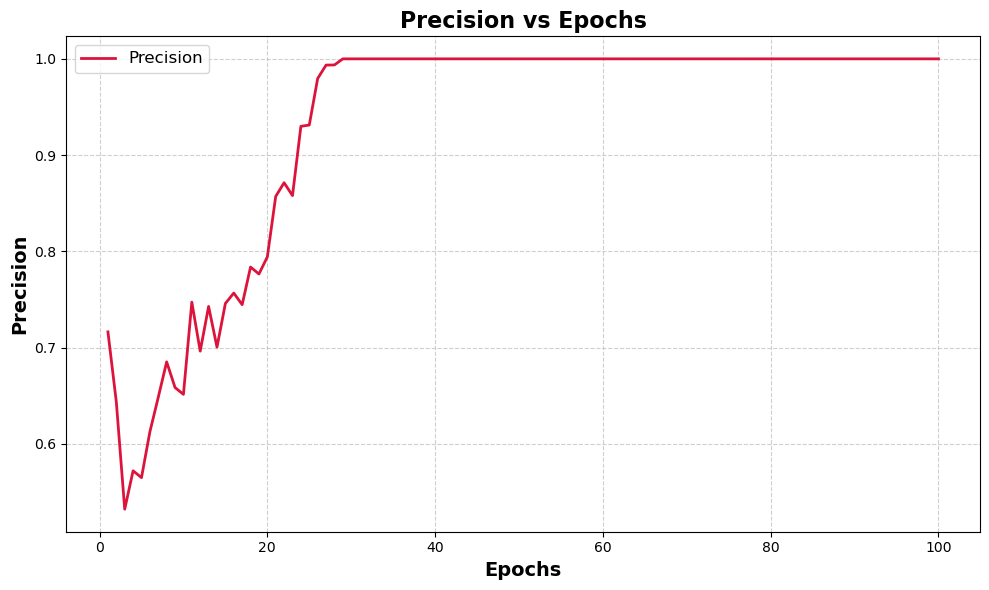

In [441]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))  # Adjust figure size
num_epochs = 100

# Plot Precision
plt.plot(range(1, num_epochs + 1), precision_values, label='Precision', color='crimson', linewidth=2)

# Formatting
plt.xlabel('Epochs', fontsize=14, fontweight='bold')
plt.ylabel('Precision', fontsize=14, fontweight='bold')
plt.title('Precision vs Epochs', fontsize=16, fontweight='bold')

# Add grid and legend
plt.grid(True, linestyle='--', alpha=0.6)
plt.legend(fontsize=12)

# Improve spacing
plt.tight_layout()

plt.savefig("precision vs epochs")
# Show the plot
plt.show()


# 11: Evaluation 

In [88]:
from tensorflow.keras.metrics import Precision, Recall

In [100]:
siamese_model = tf.keras.models.load_model('face_recognition_modelv5gerge.h5', 
                                   custom_objects={'L1Dist':L1Dist, 'BinaryCrossentropy':tf.losses.BinaryCrossentropy})

In [101]:
# Get a batch of test data
test_input, test_val, y_true = test_data.as_numpy_iterator().next()

In [102]:
y_hat = siamese_model.predict([test_input, test_val])

4/5 ━━━━━━━━━━━━━━━━━━━━ 0s 647ms/stepWARNING:tensorflow:5 out of the last 16 calls to <function TensorFlowTrainer.make_predict_function.<locals>.one_step_on_data_distributed at 0x0000022703CFE3E0> triggered tf.function retracing. Tracing is expensive and the excessive number of tracings could be due to (1) creating @tf.function repeatedly in a loop, (2) passing tensors with different shapes, (3) passing Python objects instead of tensors. For (1), please define your @tf.function outside of the loop. For (2), @tf.function has reduce_retracing=True option that can avoid unnecessary retracing. For (3), please refer to https://www.tensorflow.org/guide/function#controlling_retracing and https://www.tensorflow.org/api_docs/python/tf/function for  more details.


5/5 ━━━━━━━━━━━━━━━━━━━━ 4s 607ms/step


In [103]:
pred=[1 if prediction > 0.5 else 0 for prediction in y_hat]

In [104]:
pred

[1,
 0,
 1,
 1,
 0,
 0,
 1,
 1,
 1,
 1,
 0,
 1,
 1,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 1,
 1,
 0,
 1,
 0,
 0,
 0,
 0,
 1,
 0,
 1,
 0,
 1,
 1,
 0,
 1,
 0,
 0,
 1,
 1,
 0,
 1,
 1,
 0,
 0,
 1,
 0,
 0,
 1,
 1,
 0,
 1,
 1,
 1,
 1,
 1,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 1,
 1,
 0,
 1,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 1,
 1,
 0,
 0,
 0,
 1,
 0,
 1,
 1,
 0,
 1,
 1,
 1,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 0,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 0,
 0,
 1,
 0,
 0,
 0,
 1,
 1,
 1,
 0,
 0,
 0,
 1,
 0,
 1,
 1,
 1,
 1,
 0,
 0,
 1,
 0,
 1]

In [105]:
y_true

array([1., 0., 1., 1., 0., 0., 1., 1., 0., 0., 1., 1., 0., 1., 1., 0., 0.,
       0., 0., 0., 1., 1., 0., 1., 0., 0., 0., 0., 1., 0., 1., 0., 1., 1.,
       0., 1., 0., 1., 0., 0., 0., 0., 1., 0., 0., 1., 1., 0., 0., 1., 0.,
       0., 1., 1., 0., 1., 0., 0., 0., 1., 0., 0., 0., 0., 1., 0., 1., 0.,
       1., 1., 0., 1., 0., 1., 1., 1., 0., 0., 0., 1., 1., 1., 1., 0., 1.,
       1., 1., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 1., 1., 1., 0.,
       0., 0., 0., 1., 1., 1., 1., 0., 1., 1., 1., 0., 1., 1., 1., 1., 1.,
       0., 1., 0., 1., 1., 0., 0., 1., 0., 0.], dtype=float32)

In [106]:
from sklearn.metrics import roc_curve, auc, accuracy_score

In [107]:
fpr, tpr, thresholds = roc_curve(y_true, y_hat)
roc_auc = auc(fpr, tpr)

# Find EER
eer = fpr[np.nanargmin(np.abs(fpr - (1 - tpr)))]

# Calculate accuracy at optimal threshold
optimal_idx = np.argmax(tpr - fpr)
optimal_threshold = thresholds[optimal_idx]
y_pred = (y_hat >= optimal_threshold).astype(int)
print(eer)
print(optimal_threshold)
print(roc_auc)

0.25
0.7796405
0.8134040501446479


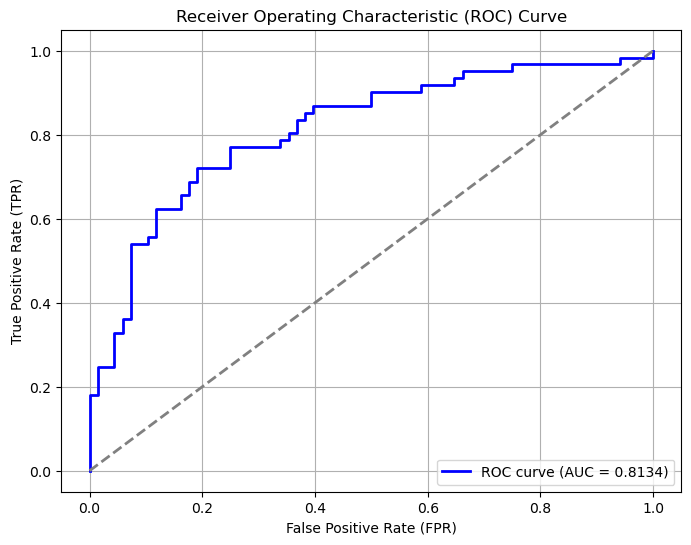

In [108]:
# plot roc curve
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', lw=2, label=f'ROC curve (AUC = {roc_auc:.4f})')  # ROC curve
plt.plot([0, 1], [0, 1], color='gray', linestyle='--', lw=2)  # Diagonal reference line
plt.xlabel('False Positive Rate (FPR)')
plt.ylabel('True Positive Rate (TPR)')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc='lower right')
plt.grid(True)
plt.show()

In [109]:
# Creating a metric object 
m = Recall()

# Calculating the recall value 
m.update_state(y_true, y_hat)

# Return Recall Result
m.result().numpy()

0.7704918

In [110]:

# Creating a metric object 
m = Precision()

# Calculating the recall value 
m.update_state(y_true, y_hat)

# Return Recall Result
m.result().numpy()

0.70149255

In [111]:
r = Recall()
p = Precision()

for test_input, test_val, y_true in test_data.as_numpy_iterator():
    yhat = siamese_model.predict([test_input, test_val])
    r.update_state(y_true, yhat)
    p.update_state(y_true,yhat) 

print(r.result().numpy(), p.result().numpy())

5/5 ━━━━━━━━━━━━━━━━━━━━ 3s 480ms/step
0.80701756 0.6764706


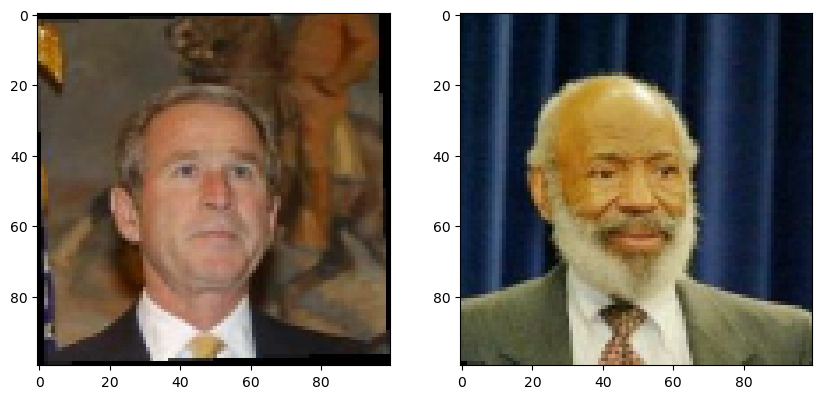

Georgeeee


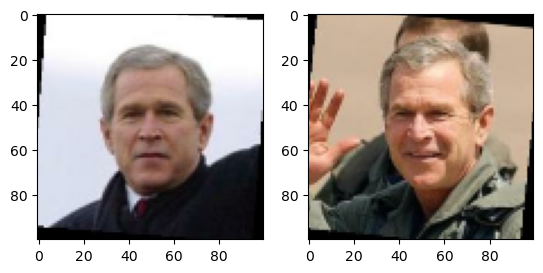

Whooooooooo


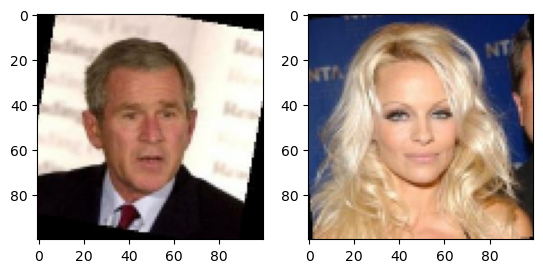

Georgeeee


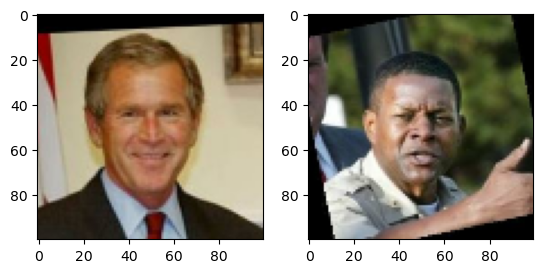

Georgeeee


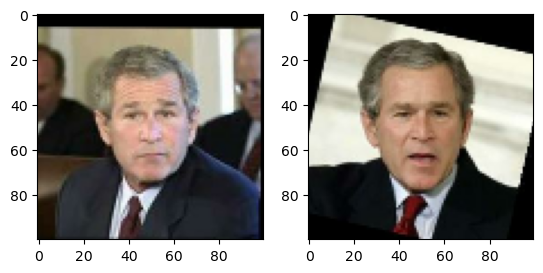

Whooooooooo


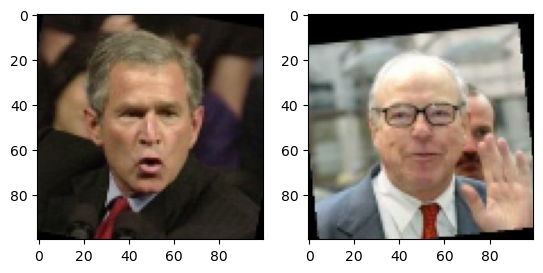

Whooooooooo


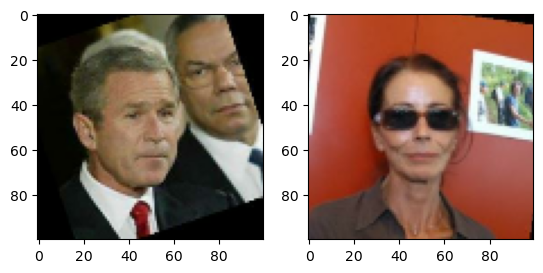

Georgeeee


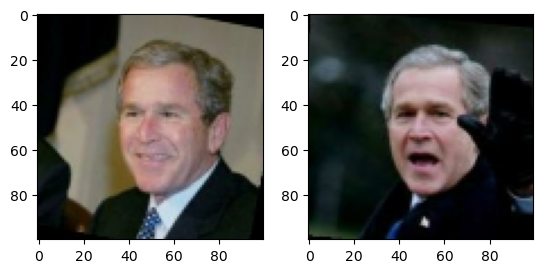

Georgeeee


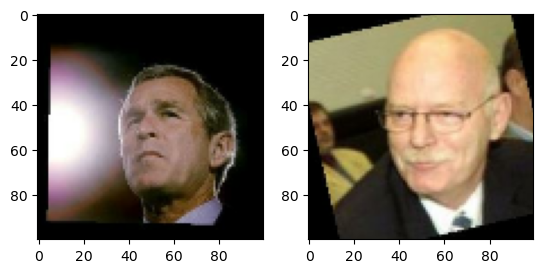

Georgeeee


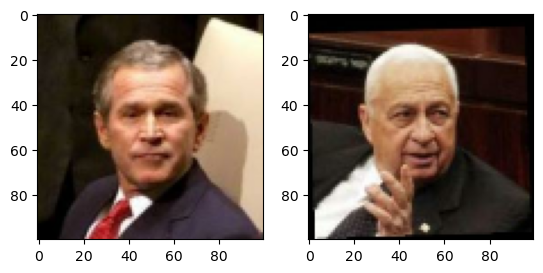

Georgeeee


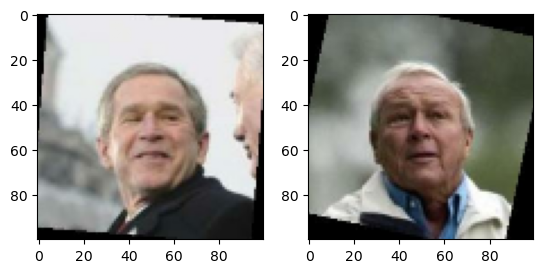

Whooooooooo


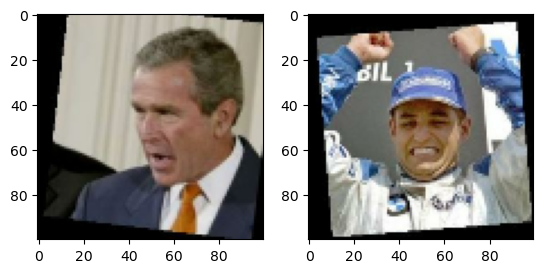

Georgeeee


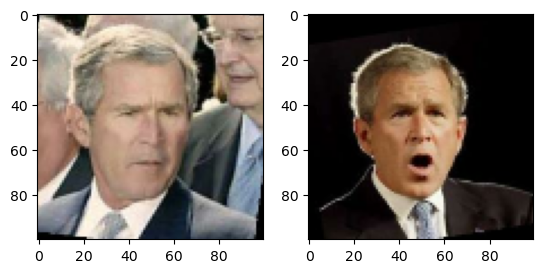

Georgeeee


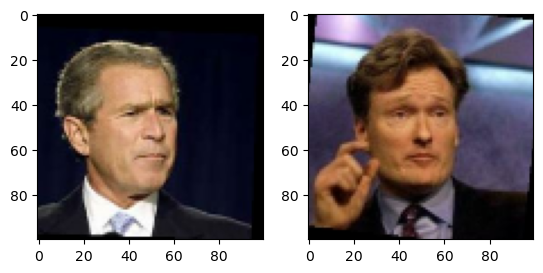

Whooooooooo


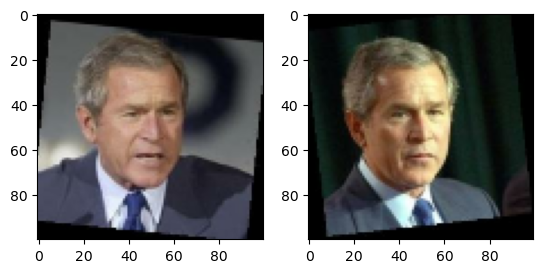

Whooooooooo


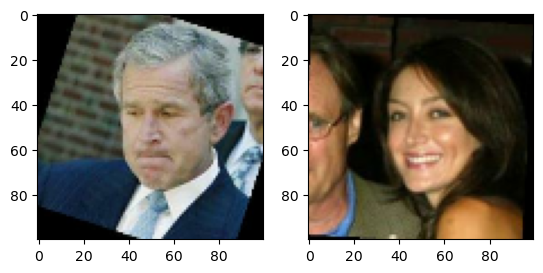

Whooooooooo


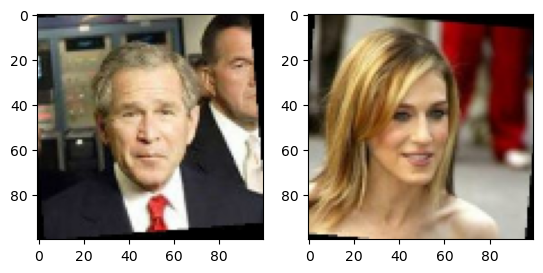

Georgeeee


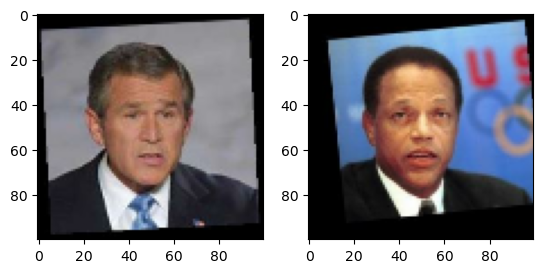

Whooooooooo


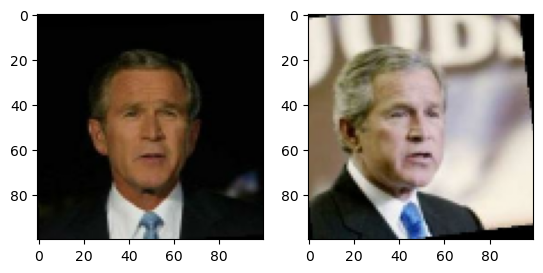

Whooooooooo


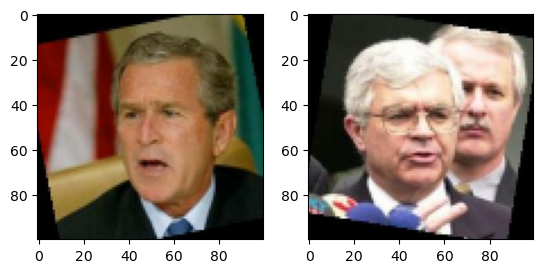

Whooooooooo


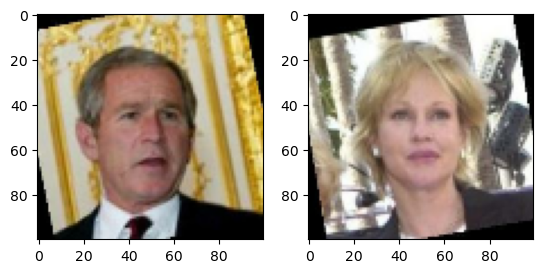

Georgeeee


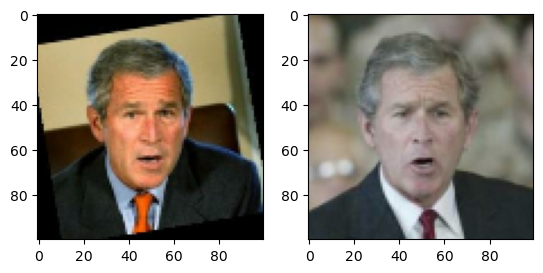

Georgeeee


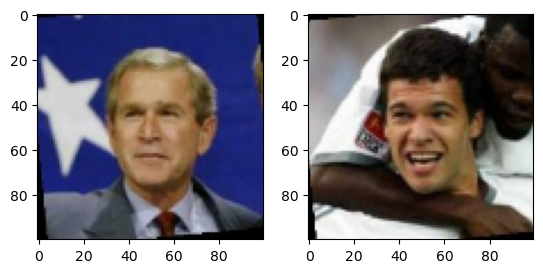

Whooooooooo


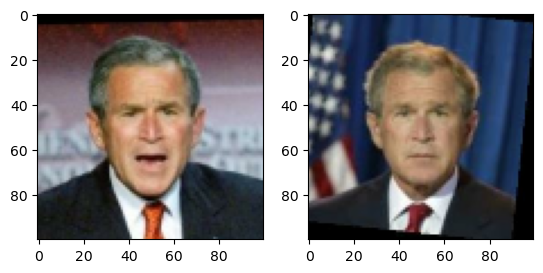

Georgeeee


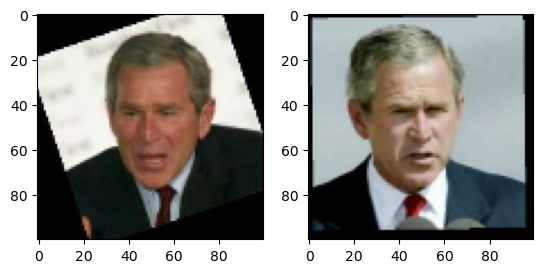

Whooooooooo


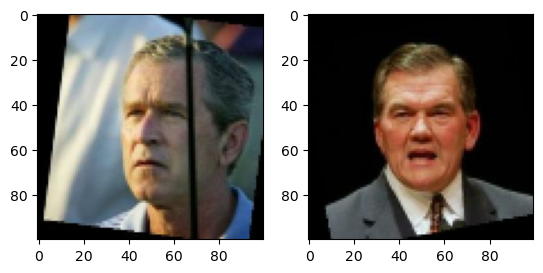

Whooooooooo


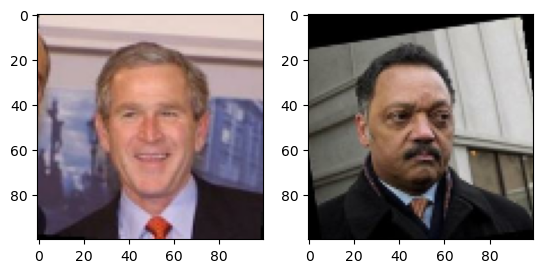

Whooooooooo


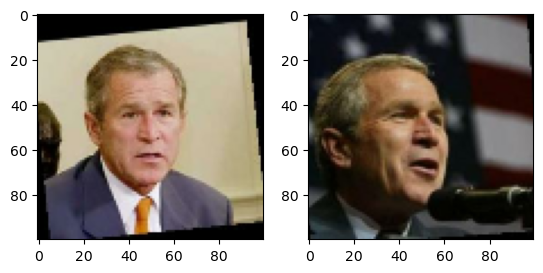

Whooooooooo


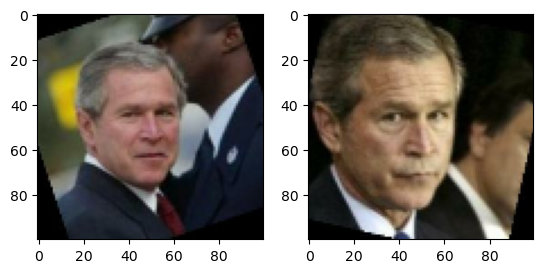

Georgeeee


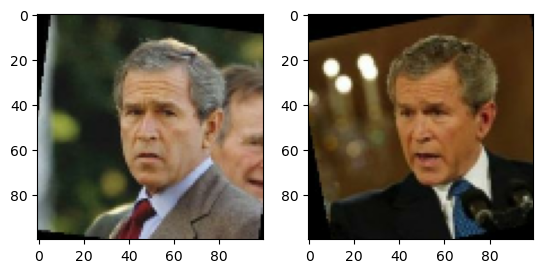

Whooooooooo


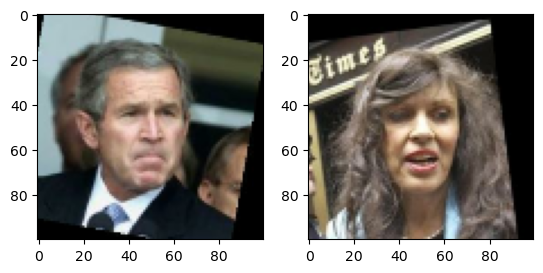

Georgeeee


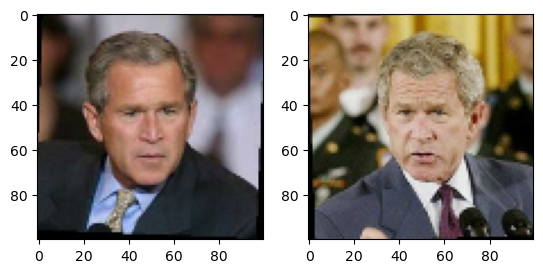

Whooooooooo


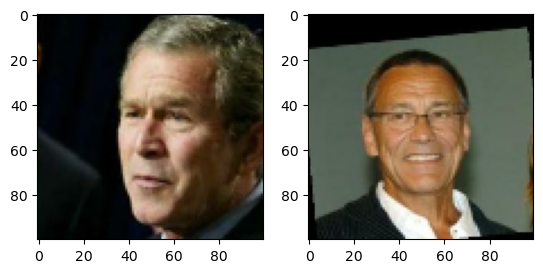

Georgeeee


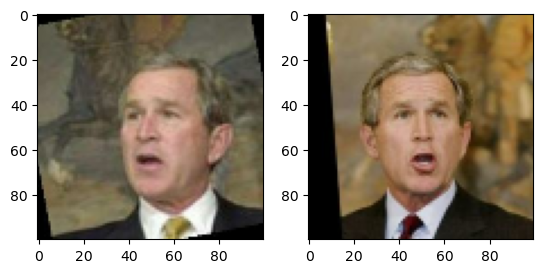

Georgeeee


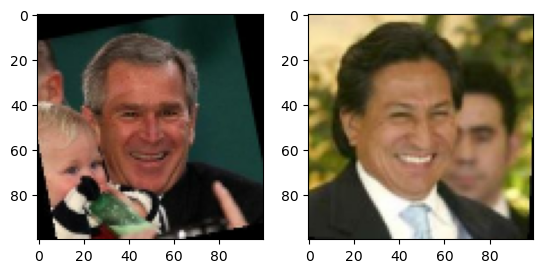

Whooooooooo


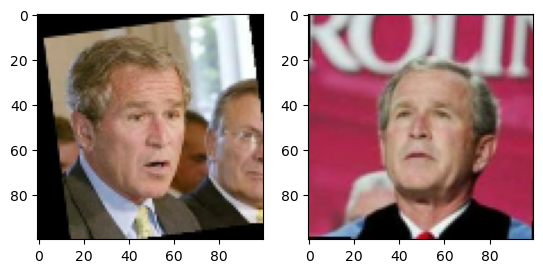

Georgeeee


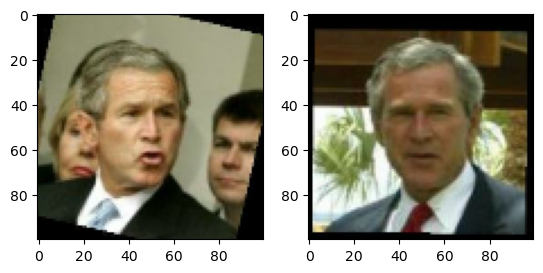

Whooooooooo


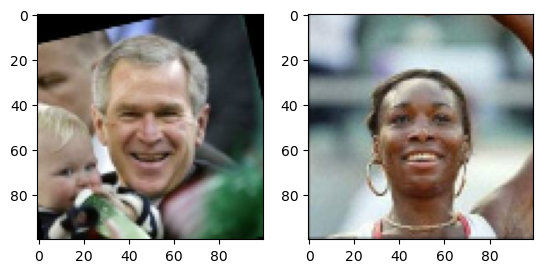

Whooooooooo


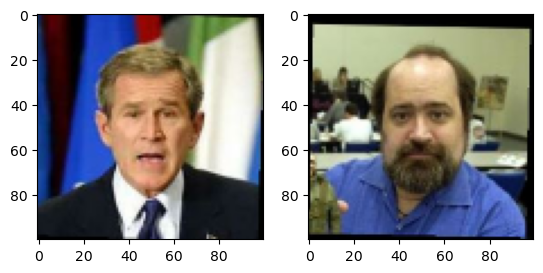

Georgeeee


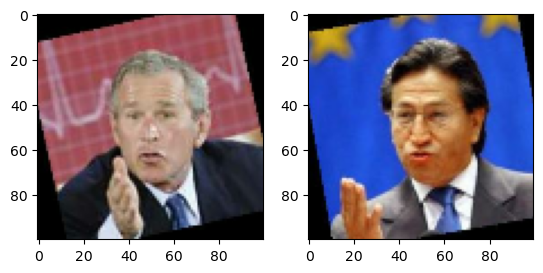

Georgeeee


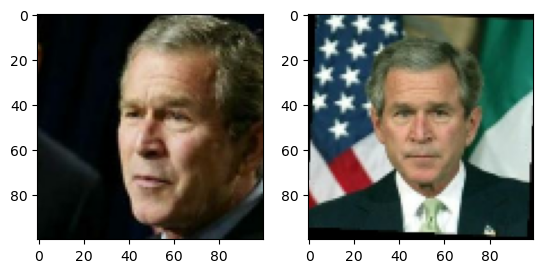

Whooooooooo


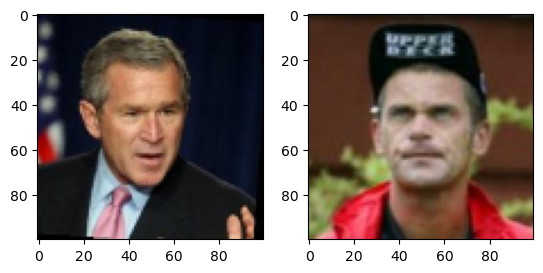

Georgeeee


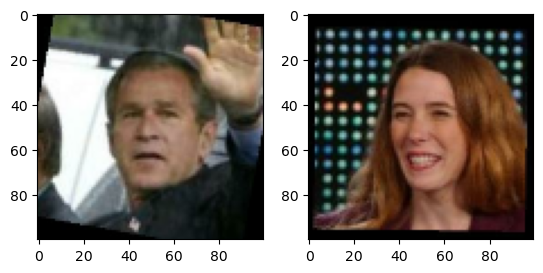

Georgeeee


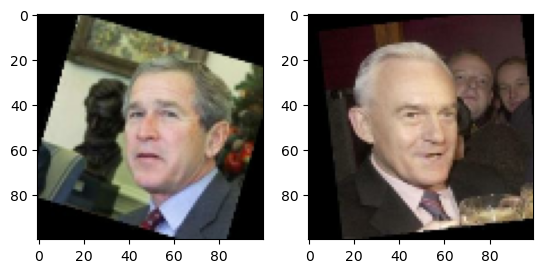

Whooooooooo


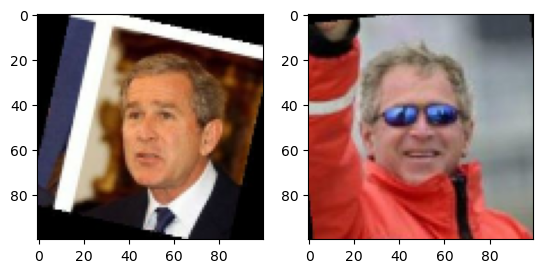

Whooooooooo


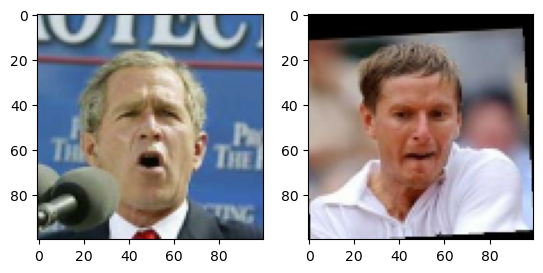

Georgeeee


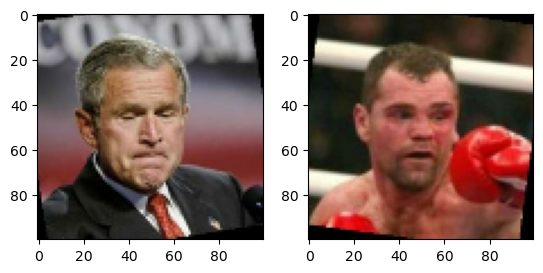

Whooooooooo


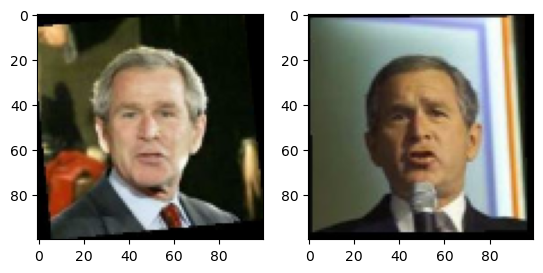

Whooooooooo


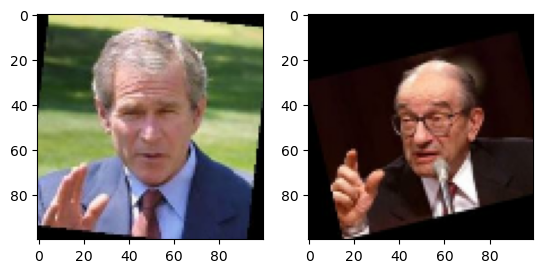

Georgeeee


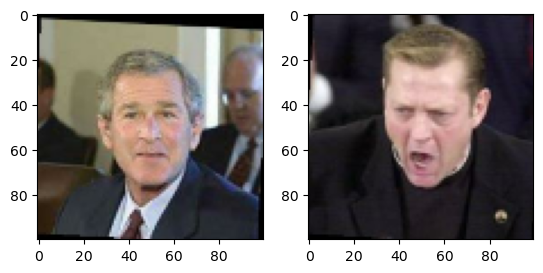

Georgeeee


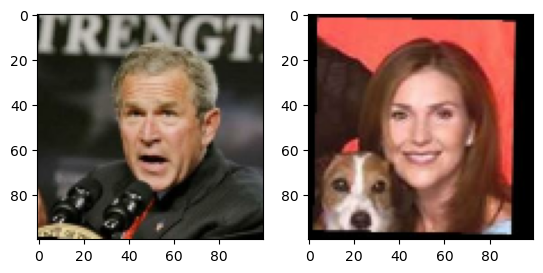

Whooooooooo


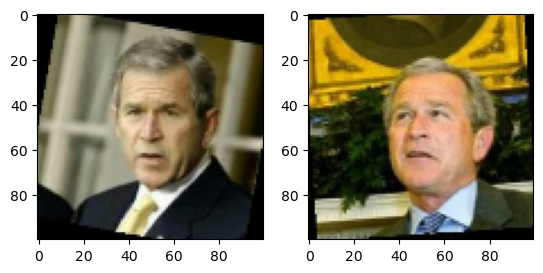

Georgeeee


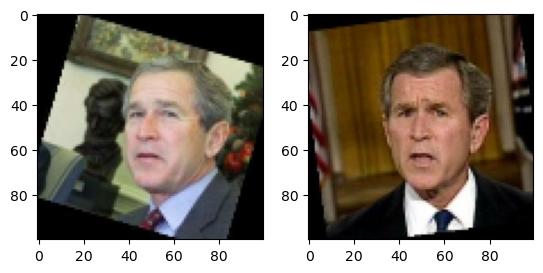

Georgeeee


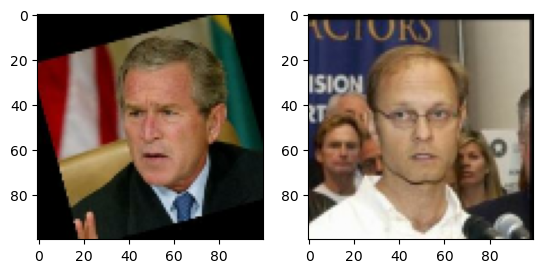

Georgeeee


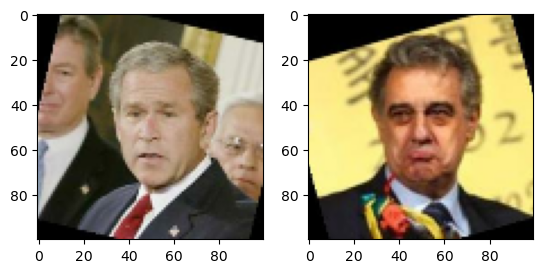

Georgeeee


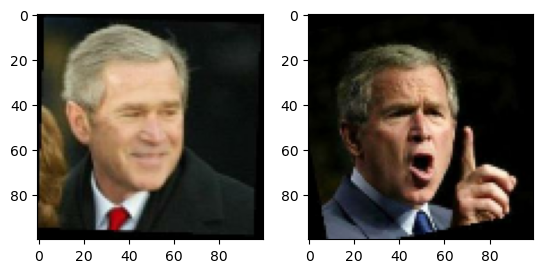

Georgeeee


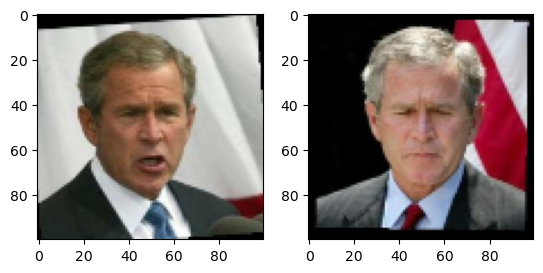

Whooooooooo


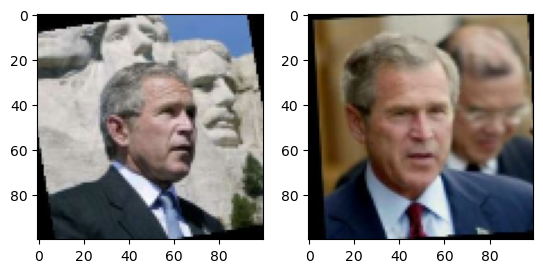

Whooooooooo


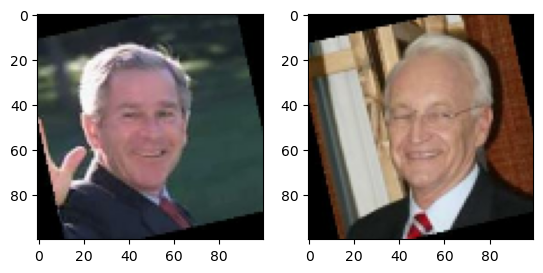

Whooooooooo


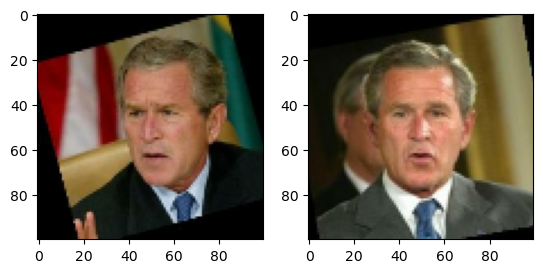

Georgeeee


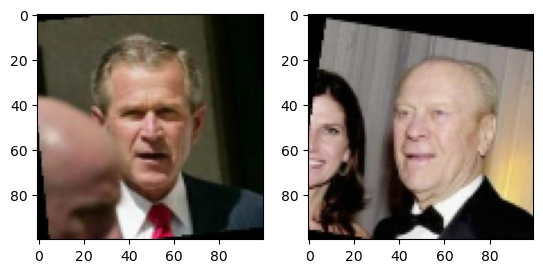

Whooooooooo


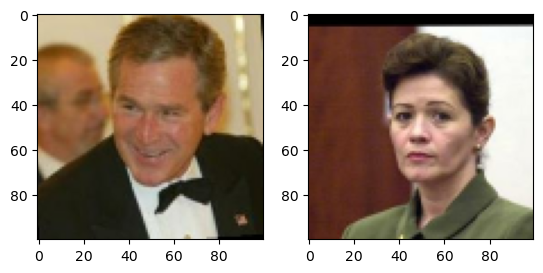

Whooooooooo


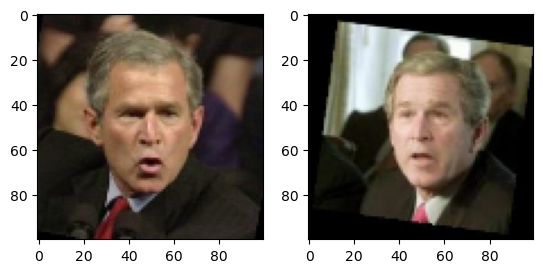

Whooooooooo


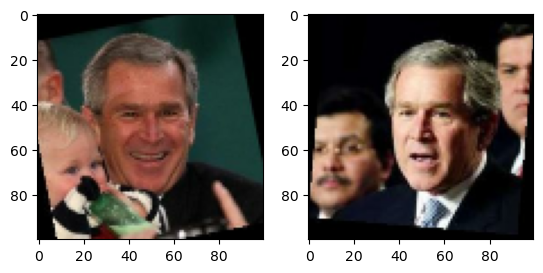

Georgeeee


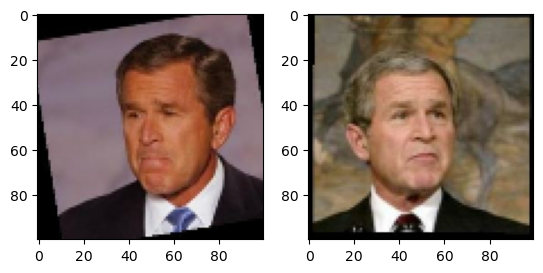

Georgeeee


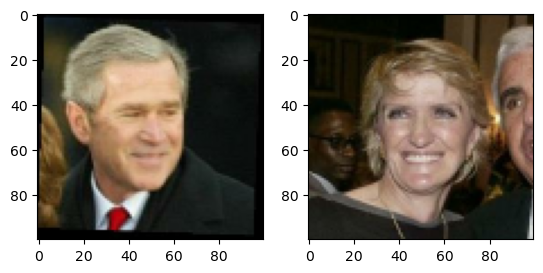

Whooooooooo


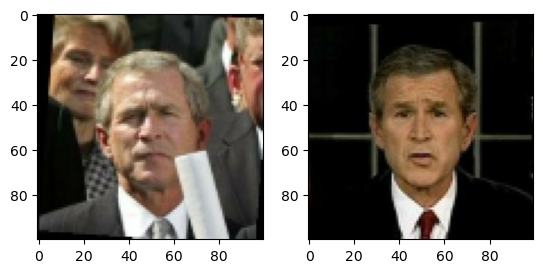

Georgeeee


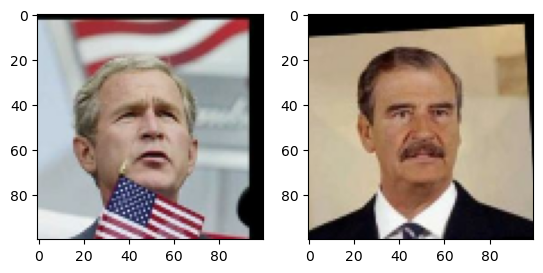

Georgeeee


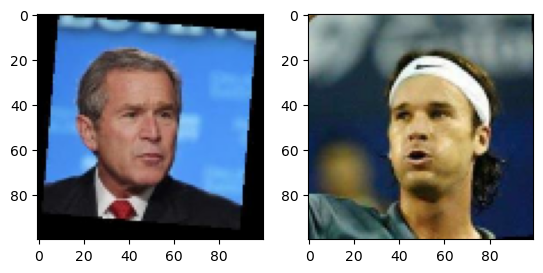

Whooooooooo


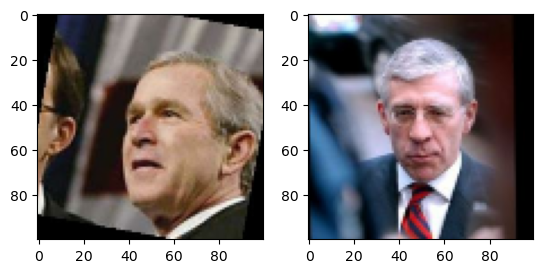

Georgeeee


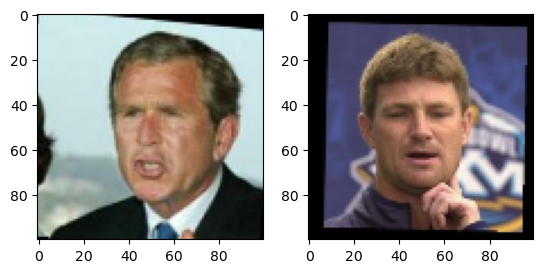

Whooooooooo


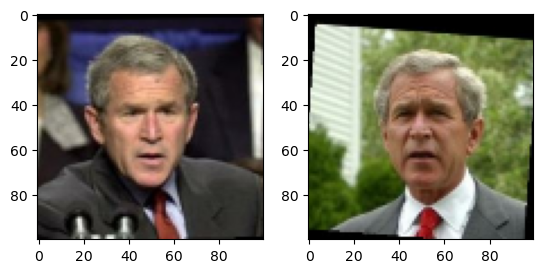

Georgeeee


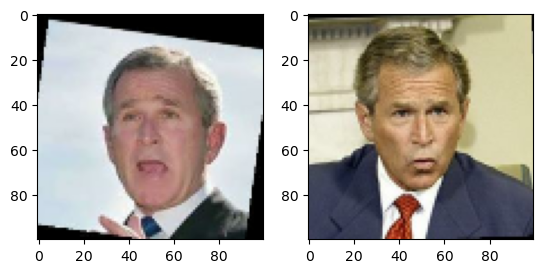

Whooooooooo


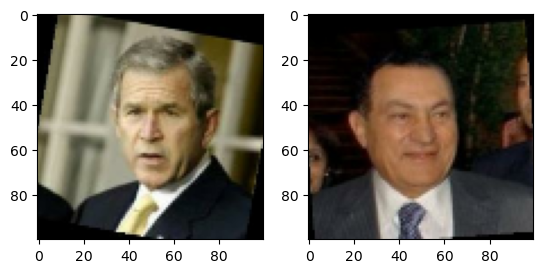

Georgeeee


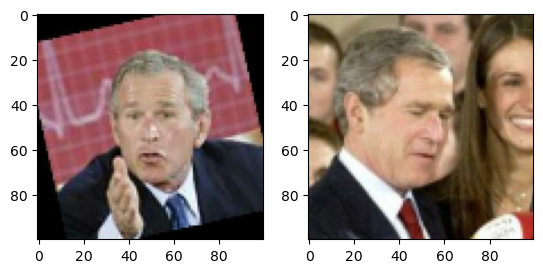

Georgeeee


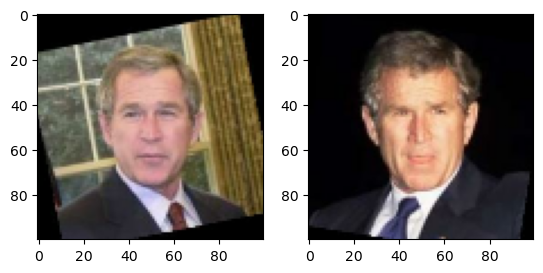

Georgeeee


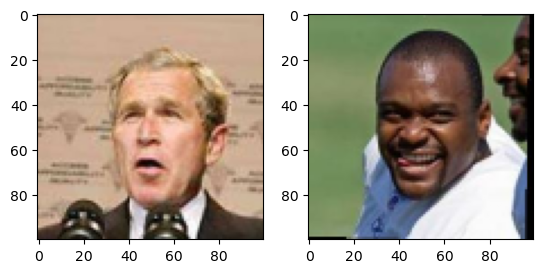

Whooooooooo


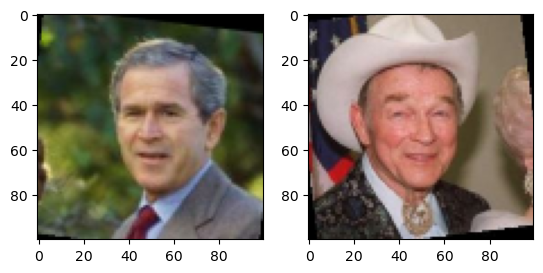

Whooooooooo


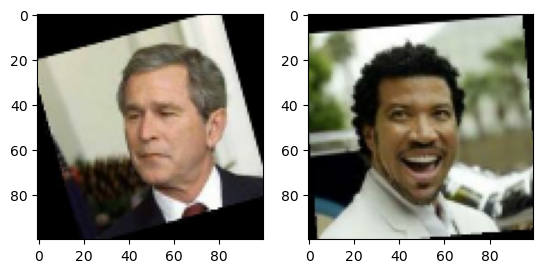

Whooooooooo


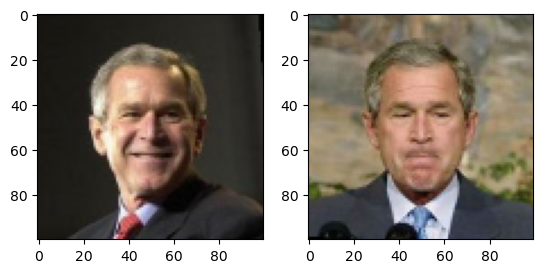

Georgeeee


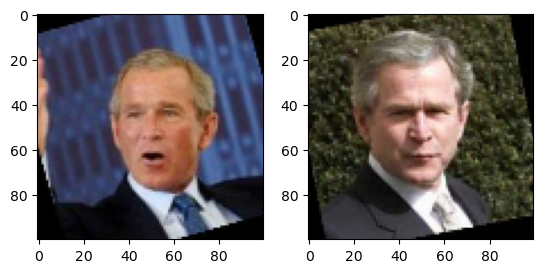

Whooooooooo


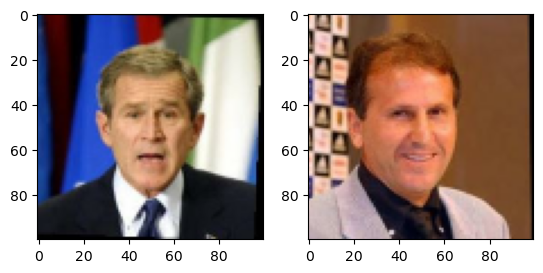

Georgeeee


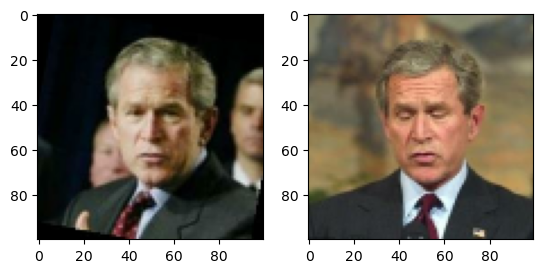

Georgeeee


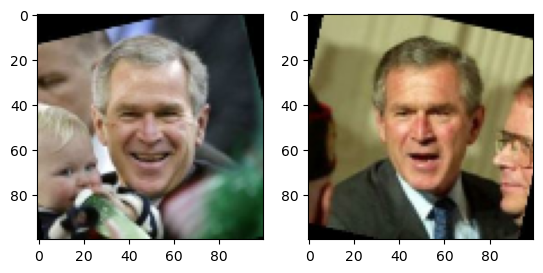

Whooooooooo


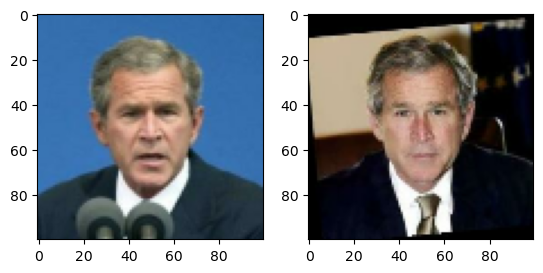

Georgeeee


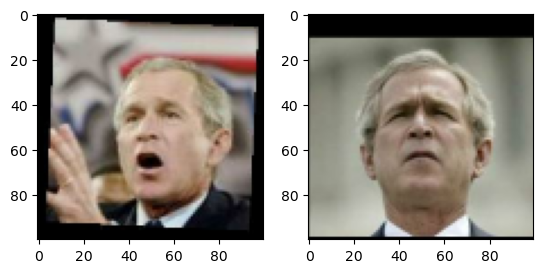

Georgeeee


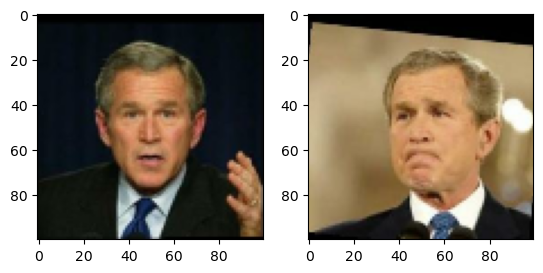

Georgeeee


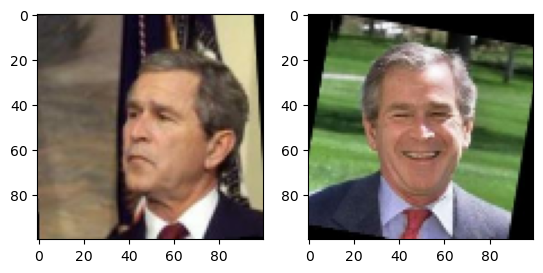

Whooooooooo


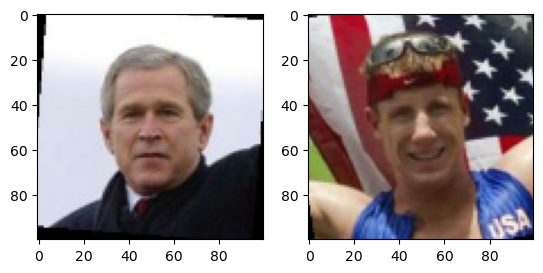

Whooooooooo


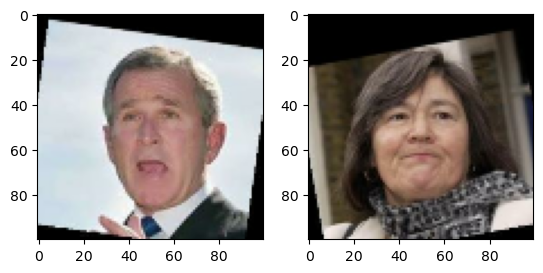

Whooooooooo


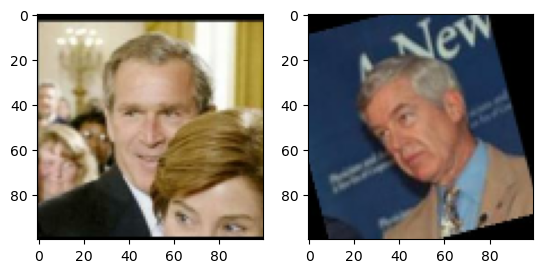

Whooooooooo


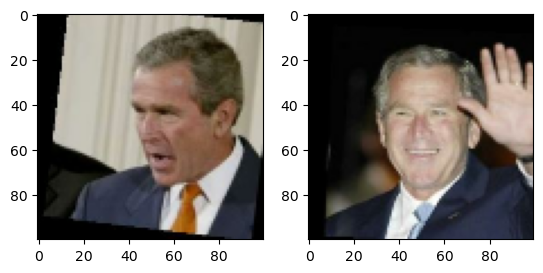

Whooooooooo


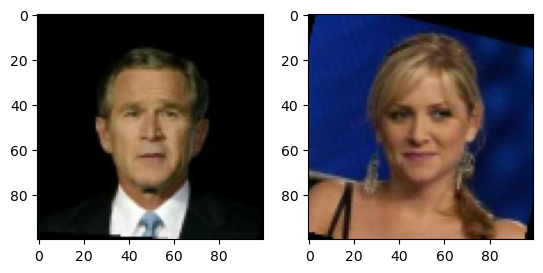

Whooooooooo


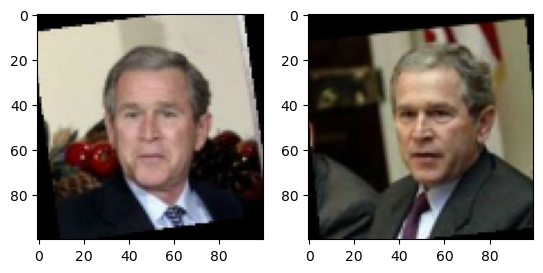

Whooooooooo


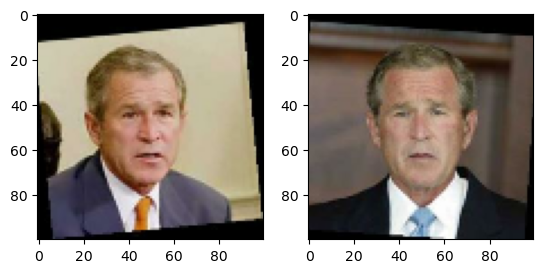

Georgeeee


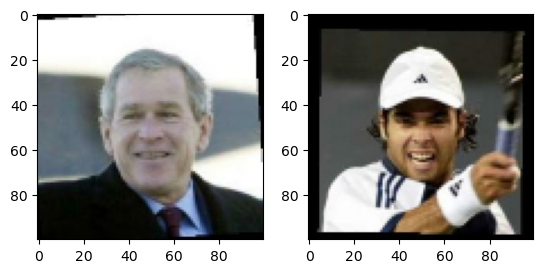

Whooooooooo


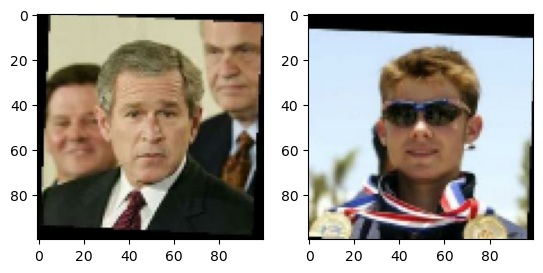

Whooooooooo


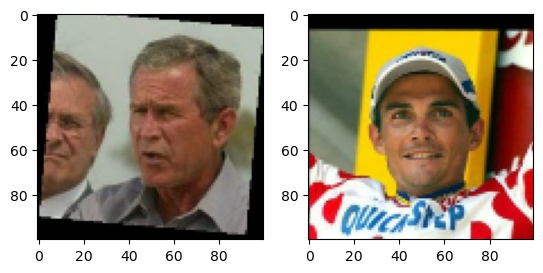

Georgeeee


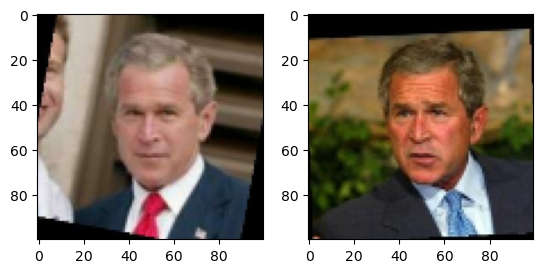

Georgeeee


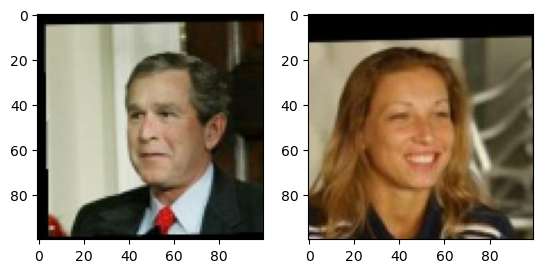

Georgeeee


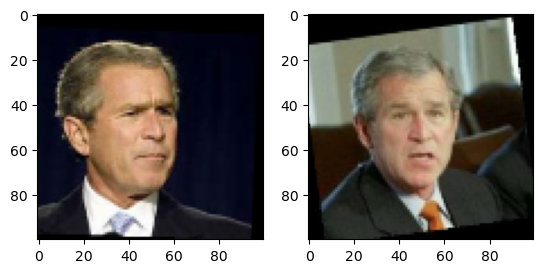

Georgeeee


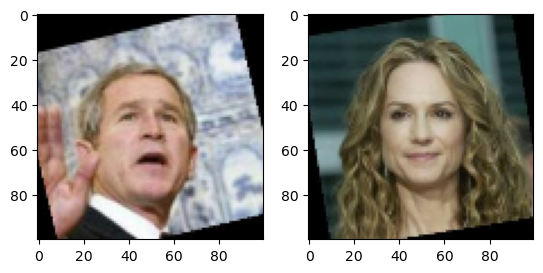

Georgeeee


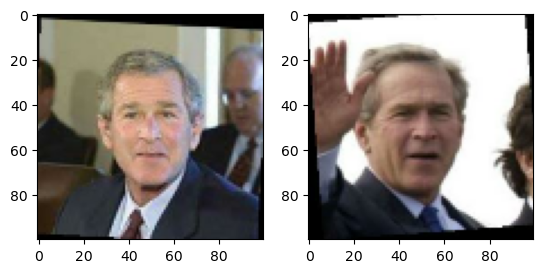

Georgeeee


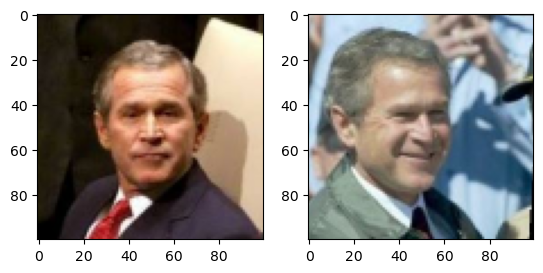

Georgeeee


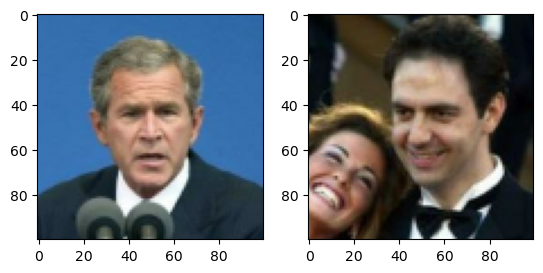

Georgeeee


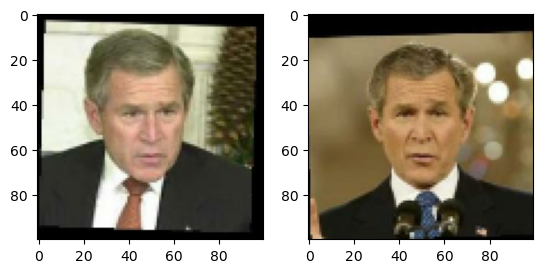

Georgeeee


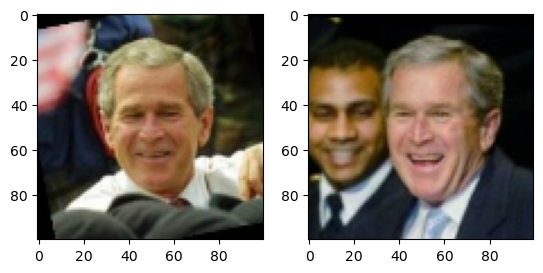

Whooooooooo


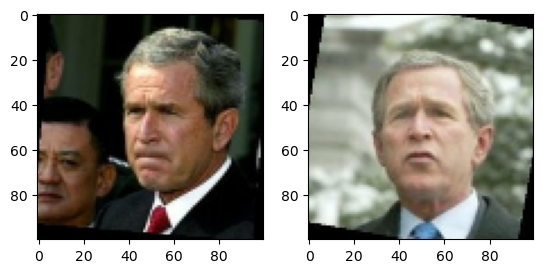

Whooooooooo


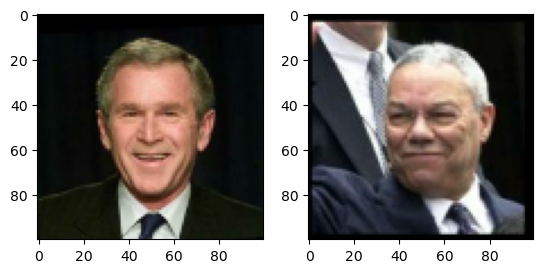

Georgeeee


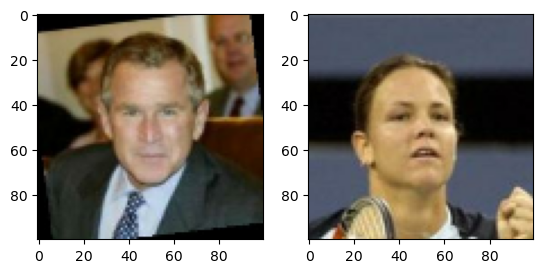

Whooooooooo


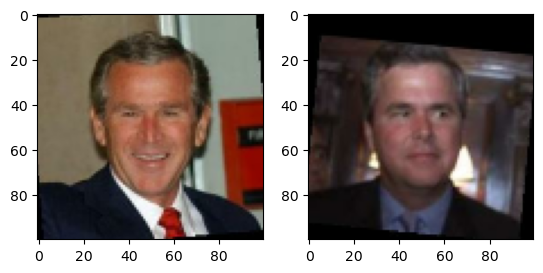

Whooooooooo


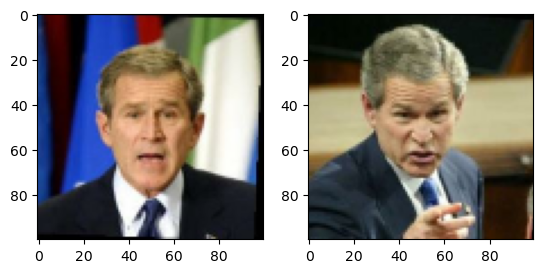

Whooooooooo


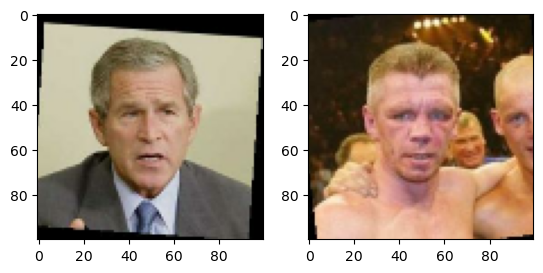

Georgeeee


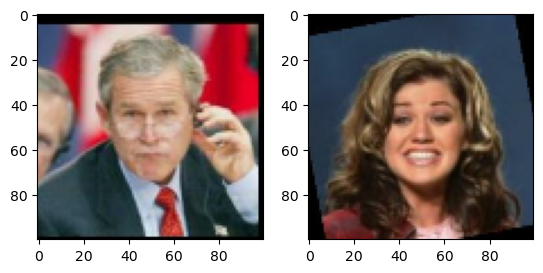

Georgeeee


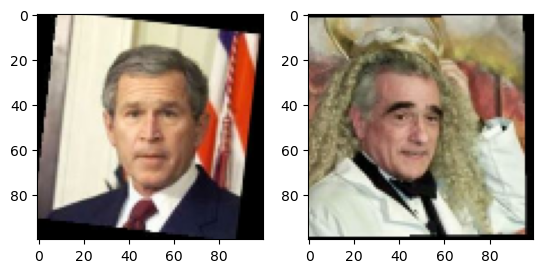

Georgeeee


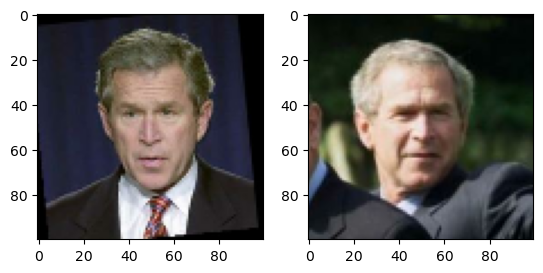

Whooooooooo


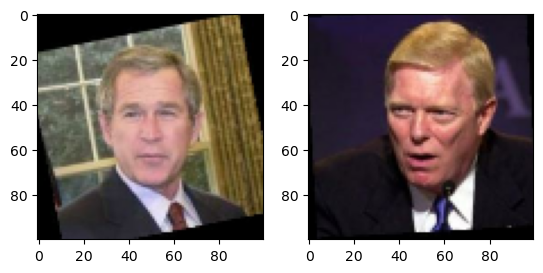

Whooooooooo


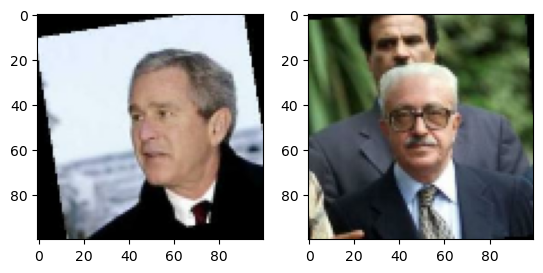

Whooooooooo


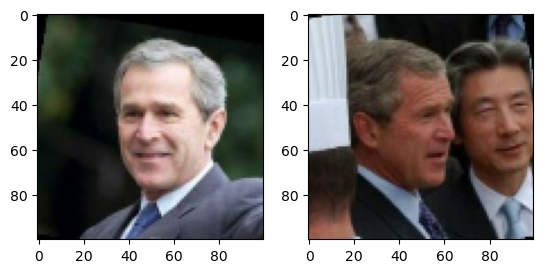

Georgeeee


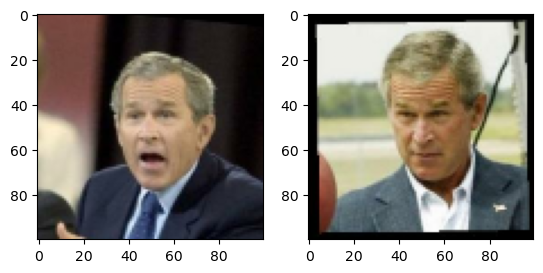

Whooooooooo


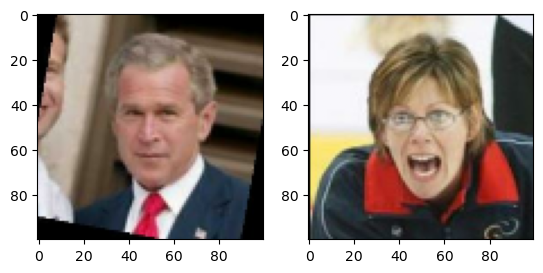

Georgeeee


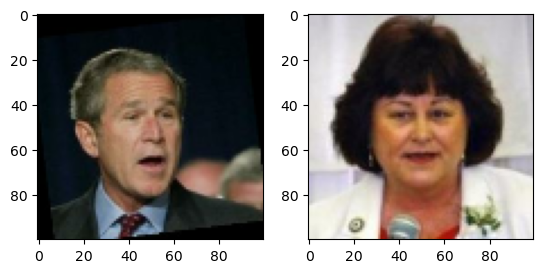

Georgeeee


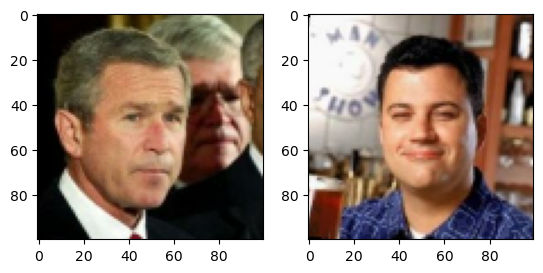

Georgeeee


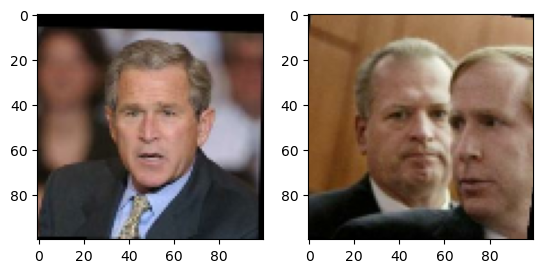

Georgeeee


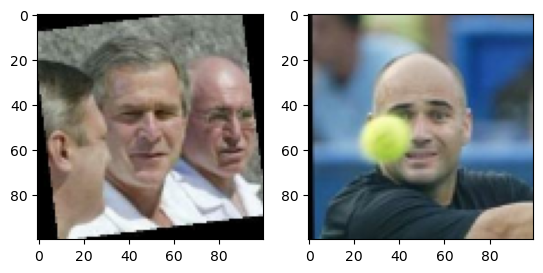

Whooooooooo


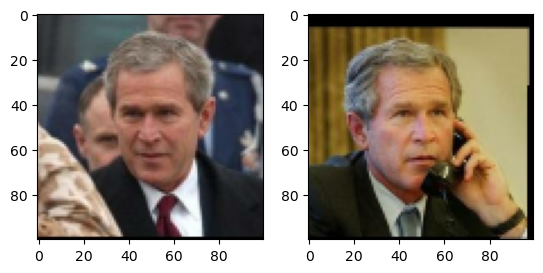

Whooooooooo


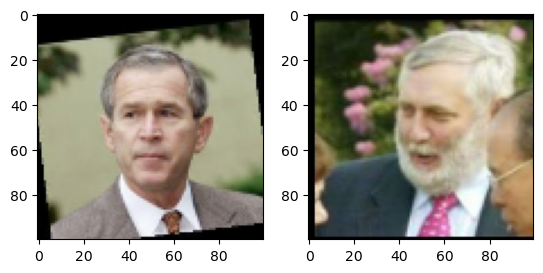

Georgeeee


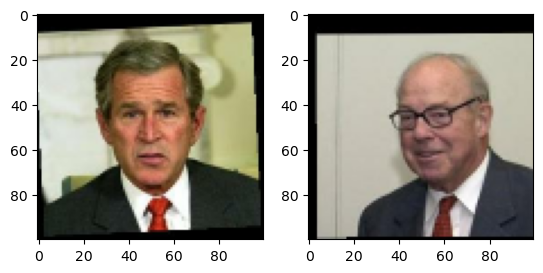

Whooooooooo


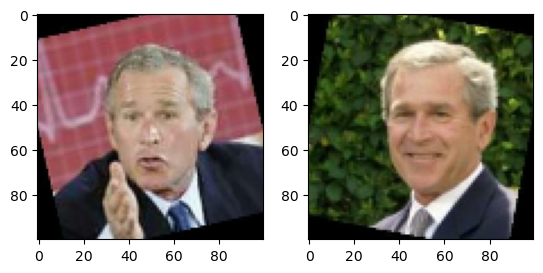

Georgeeee


IndexError: index 129 is out of bounds for axis 0 with size 129

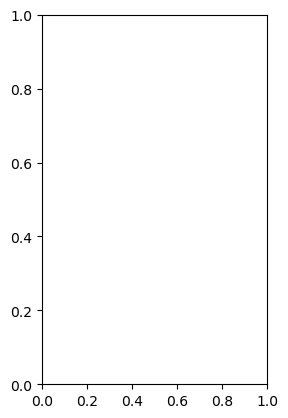

In [112]:
# Set plot size 
plt.figure(figsize=(10,8))

for i in range (0,199):
# Set first subplot
    plt.subplot(1,2,1)
    plt.imshow(test_input[i])
    
    # Set second subplot
    plt.subplot(1,2,2)
    plt.imshow(test_val[i])
    
    # Renders cleanly
    plt.show()
    if pred[i] == 1:
        print("Georgeeee")
    else:
        print("Whooooooooo")

In [467]:
# Save weights
siamese_model.save('face_recognition_modelv6.h5')

# 12: Reloading Model

In [120]:

L1Dist

__main__.L1Dist

In [121]:

# # Reload model 
siamese_model = tf.keras.models.load_model('face_recognition_modelv5gerge.h5', 
                                   custom_objects={'L1Dist':L1Dist, 'BinaryCrossentropy':tf.losses.BinaryCrossentropy})
# siamese_model = tf.keras.models.load_model(
#     'face_recognition_modelv4.h5',
#     custom_objects={'L1Dist': L1Dist},
#     compile=False  # Prevents compilation issues
# )


In [122]:
siamese_model.compile(
    optimizer=tf.keras.optimizers.Adam(),
    loss=tf.losses.BinaryCrossentropy(),
    metrics=['accuracy']
)


In [135]:
test_input, test_val, y_true = test_data.as_numpy_iterator().next()

In [136]:
y_hat = siamese_model.predict([test_input, test_val])

1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


In [137]:
[1 if prediction > 0.5 else 0 for prediction in y_hat]

[0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0]

In [138]:
y_true

array([0., 0., 0., 1., 1., 1., 1., 0., 0., 0., 0., 0., 1., 1., 0., 0.],
      dtype=float32)

In [123]:
# Make predictions with reloaded model
siamese_model.predict([test_input, test_val])

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


array([[0.99999833]], dtype=float32)

In [128]:
os.listdir(os.path.join('application_data', 'verification_images'))

['b68baf81-edb7-11ef-9844-f47b09537135.jpg',
 'b6cd1b15-ec0e-11ef-a25e-f47b09537135.jpg',
 'b6d3d294-ec0e-11ef-9b68-f47b09537135.jpg',
 'b6e1ecff-ec0e-11ef-8bcc-f47b09537135.jpg',
 'b6effd6a-ec0e-11ef-a1f1-f47b09537135.jpg',
 'b6fe5e30-ec0e-11ef-bcc7-f47b09537135.jpg',
 'b77b8592-edb7-11ef-a080-f47b09537135.jpg',
 'b7805ac7-edb7-11ef-bf17-f47b09537135.jpg',
 'b785319e-edb7-11ef-9647-f47b09537135.jpg',
 'b789e891-edb7-11ef-abf1-f47b09537135.jpg',
 'b78eb8ae-edb7-11ef-b7c0-f47b09537135.jpg',
 'b79368f5-edb7-11ef-92db-f47b09537135.jpg',
 'b7c47d59-ec0e-11ef-8977-f47b09537135.jpg',
 'b8abd1a5-ec0e-11ef-9642-f47b09537135.jpg',
 'b9a2c732-ec0e-11ef-a7a0-f47b09537135.jpg',
 'b9b0f435-ec0e-11ef-81e9-f47b09537135.jpg']

In [129]:
os.path.join('application_data', 'input_image', 'input_image.jpg')

'application_data\\input_image\\input_image.jpg'

In [130]:
for image in os.listdir(os.path.join('application_data', 'verification_images')):
    validation_img = os.path.join('application_data', 'verification_images', image)
    print(validation_img)

application_data\verification_images\b68baf81-edb7-11ef-9844-f47b09537135.jpg
application_data\verification_images\b6cd1b15-ec0e-11ef-a25e-f47b09537135.jpg
application_data\verification_images\b6d3d294-ec0e-11ef-9b68-f47b09537135.jpg
application_data\verification_images\b6e1ecff-ec0e-11ef-8bcc-f47b09537135.jpg
application_data\verification_images\b6effd6a-ec0e-11ef-a1f1-f47b09537135.jpg
application_data\verification_images\b6fe5e30-ec0e-11ef-bcc7-f47b09537135.jpg
application_data\verification_images\b77b8592-edb7-11ef-a080-f47b09537135.jpg
application_data\verification_images\b7805ac7-edb7-11ef-bf17-f47b09537135.jpg
application_data\verification_images\b785319e-edb7-11ef-9647-f47b09537135.jpg
application_data\verification_images\b789e891-edb7-11ef-abf1-f47b09537135.jpg
application_data\verification_images\b78eb8ae-edb7-11ef-b7c0-f47b09537135.jpg
application_data\verification_images\b79368f5-edb7-11ef-92db-f47b09537135.jpg
application_data\verification_images\b7c47d59-ec0e-11ef-8977-f47

In [131]:
def verify(model, detection_threshold, verification_threshold):
    # Build results array
    results = []
    for image in os.listdir(os.path.join('application_data', 'verification_images')):
        input_img = preprocess(os.path.join('application_data', 'input_image', 'input_image.jpg'))
        validation_img = preprocess(os.path.join('application_data', 'verification_images', image))
        
        # Make Predictions 
        result = model.predict(list(np.expand_dims([input_img, validation_img], axis=1)))
        results.append(result)
    
    # Detection Threshold: Metric above which a prediciton is considered positive 
    detection = np.sum(np.array(results) > detection_threshold)
    
    # Verification Threshold: Proportion of positive predictions / total positive samples 
    verification = detection / len(os.listdir(os.path.join('application_data', 'verification_images'))) 
    verified = verification > verification_threshold
    
    return results, verified

In [139]:
cap = cv2.VideoCapture(0)
while cap.isOpened():
    ret, frame = cap.read()
    frame = frame[120:120+250,200:200+250, :]
    
    cv2.imshow('Verification', frame)
    
    # Verification trigger
    if cv2.waitKey(1) & 0xFF == ord('v'):
        cv2.imwrite(os.path.join('application_data', 'input_image', 'input_image.jpg'), frame)
        # Run verification
        results, verified = verify(siamese_model, 0.5, 0.5)
        print(verified)
    
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break
cap.release()
cv2.destroyAllWindows()

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
True


In [127]:
# Establish a connection to the webcam
cap = cv2.VideoCapture(0)
while cap.isOpened(): 
    ret, frame = cap.read()
   
    # Cut down frame to 250x250px
    frame = frame[120:120+250,200:200+250, :]
    
    # Collect anchors 
    if cv2.waitKey(1) & 0XFF == ord('c'):
        # Create the unique file path 
        imgname = os.path.join(VAL_PATH, '{}.jpg'.format(uuid.uuid1()))
        # Write out anchor image
        cv2.imwrite(imgname, frame)
    
    
    # Show image back to screen
    cv2.imshow('Image Collection', frame)
    
    # Breaking gracefully
    if cv2.waitKey(1) & 0XFF == ord('q'):
        break
        
# Release the webcam
cap.release()
# Close the image show frame
cv2.destroyAllWindows()